# Построение модели для предсказания температуры стали

**Задача:**  
Построить модель для предсказания температуры сплава (т.е. последней измеренной температуры по всей партии), которая обеспечит целевую метрику МАЕ < 6.8 на тесте.

**Описание данных:**  
Данные состоят из файлов, полученных из разных источников:

- `data_arc_new.csv` — данные об электродах;
- `data_bulk_new.csv` — данные о подаче сыпучих материалов (объём);
- `data_bulk_time_new.csv` *—* данные о подаче сыпучих материалов (время);
- `data_gas_new.csv` — данные о продувке сплава газом;
- `data_temp_new.csv` — результаты измерения температуры;
- `data_wire_new.csv` — данные о проволочных материалах (объём);
- `data_wire_time_new.csv` — данные о проволочных материалах (время).

Во всех файлах столбец `key` содержит номер партии. В файлах может быть несколько строк с одинаковым значением `key`: они соответствуют разным итерациям обработки.

## Импорт библиотек

In [1]:
# !echo $PYTHONWARNINGS
# !pip install shap
# !pip install --upgrade pandas_profiling
# !pip install --upgrade matplotlib

In [2]:
import os
os.environ['PYTHONWARNINGS'] = 'ignore'

import warnings
warnings.filterwarnings('ignore')

from catboost import CatBoostRegressor

import datetime

from ipywidgets import Checkbox, VBox, Layout

import lightgbm as lgb
from lightgbm import LGBMRegressor

import numpy as np

import pandas as pd
from pandas_profiling import ProfileReport

import matplotlib.pyplot as plt
%matplotlib inline

import phik
from phik.report import plot_correlation_matrix
from phik import report

import seaborn as sns
import shap
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_absolute_error
from sklearn.metrics import r2_score
from sklearn.model_selection import RandomizedSearchCV
from sklearn.model_selection import train_test_split
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler

import time

RANDOM_STATE = 50623

## EDA

Откроем файлы:

In [3]:
pth1 = '/datasets/'
pth2 = '/Users/darakasina/Desktop/DS/Проекты/project_steel_temp_pred_kashina/'

files = ['data_arc_new.csv',
         'data_bulk_new.csv', 
         'data_bulk_time_new.csv', 
         'data_gas_new.csv', 
         'data_temp_new.csv', 
         'data_wire_new.csv', 
         'data_wire_time_new.csv']

for file in files:
    df_name = file.split('_new.')[0]
    if os.path.exists(pth1):
        globals()[df_name] = pd.read_csv(pth1+file)  
    elif os.path.exists(pth2):
        globals()[df_name] = pd.read_csv(pth2+file) 
    else:
        print('Something is wrong')

### data_arc

*Данные об электродах*

Изучим общую информацию о полученном датафрейме:

In [4]:
data_arc.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 14876 entries, 0 to 14875
Data columns (total 5 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   key                   14876 non-null  int64  
 1   Начало нагрева дугой  14876 non-null  object 
 2   Конец нагрева дугой   14876 non-null  object 
 3   Активная мощность     14876 non-null  float64
 4   Реактивная мощность   14876 non-null  float64
dtypes: float64(2), int64(1), object(2)
memory usage: 581.2+ KB


In [5]:
data_arc = data_arc.rename(columns={'Начало нагрева дугой':'arc_heating_start', 
                                    'Конец нагрева дугой':'arc_heating_end', 
                                    'Активная мощность':'active_power',
                                    'Реактивная мощность':'reactive_power'}
                          )

In [6]:
data_arc = data_arc.drop_duplicates()

In [7]:
data_arc.head(3)

,key,arc_heating_start,arc_heating_end,active_power,reactive_power
0,1,2019-05-03 11:02:14,2019-05-03 11:06:02,0.305130,0.211253
1,1,2019-05-03 11:07:28,2019-05-03 11:10:33,0.765658,0.477438
2,1,2019-05-03 11:11:44,2019-05-03 11:14:36,0.580313,0.430460


Приведем столбцы `arc_heating_start` и `arc_heating_end` к типу datetime:

In [8]:
data_arc[['arc_heating_start', 
          'arc_heating_end']] = data_arc[['arc_heating_start', 
                                          'arc_heating_end']].apply(pd.to_datetime)

In [9]:
data_arc.head(3)

,key,arc_heating_start,arc_heating_end,active_power,reactive_power
0,1,2019-05-03 11:02:14,2019-05-03 11:06:02,0.305130,0.211253
1,1,2019-05-03 11:07:28,2019-05-03 11:10:33,0.765658,0.477438
2,1,2019-05-03 11:11:44,2019-05-03 11:14:36,0.580313,0.430460


In [10]:
data_arc.dtypes

key                           int64
arc_heating_start    datetime64[ns]
arc_heating_end      datetime64[ns]
active_power                float64
reactive_power              float64
dtype: object

Кол-во уникальных значений по столбцам:

In [11]:
data_arc.nunique()

key                   3214
arc_heating_start    14876
arc_heating_end      14876
active_power         13846
reactive_power       14707
dtype: int64

In [12]:
data_arc_orig_size = data_arc.shape[0]
data_arc_orig_size

14876

Всего в нашем распоряжении данные по 3214 партиям.

Построим профайл для data_arc для выявления зависимостей и интересных особенностей:

In [13]:
profile = ProfileReport(data_arc, progress_bar=False)
profile

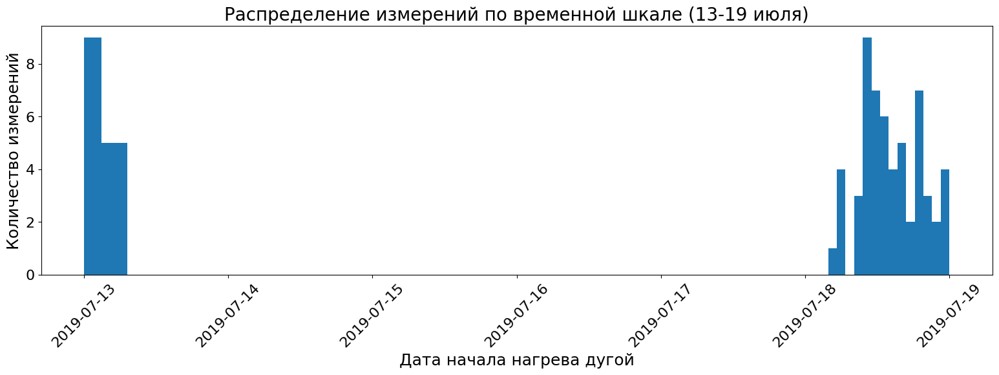

In [14]:
data = data_arc[(data_arc.arc_heating_start.dt.month == 7) & 
                (data_arc.arc_heating_start.dt.day > 12) & 
                (data_arc.arc_heating_start.dt.day < 19)].arc_heating_start

plt.figure(figsize=(19,5))
plt.hist(data, bins=100)
plt.xlabel('Дата начала нагрева дугой', fontsize=18)
plt.xticks(rotation=45, fontsize=16)
plt.ylabel('Количество измерений', fontsize=18)
plt.yticks(fontsize=16)
plt.title('Распределение измерений по временной шкале (13-19 июля)', fontsize=20)
plt.show()

In [15]:
data_arc = data_arc[data_arc.key != data_arc.loc[data_arc['reactive_power'] < 0, 'key'].values[0]]
data_arc.nunique()

key                   3213
arc_heating_start    14872
arc_heating_end      14872
active_power         13843
reactive_power       14703
dtype: int64

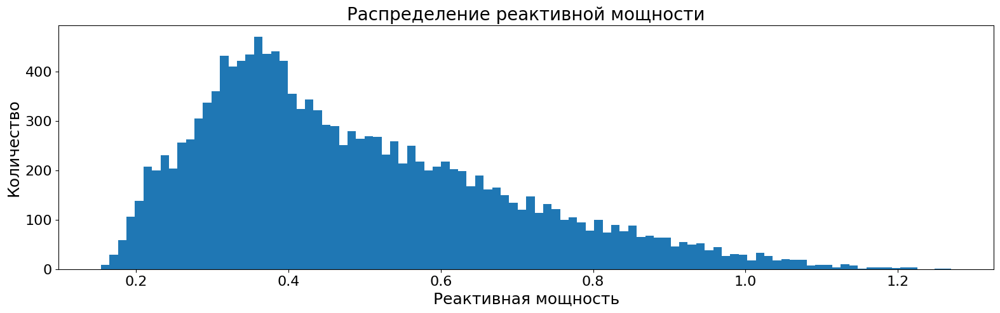

In [16]:
data = data_arc.reactive_power

plt.figure(figsize=(19,5))
plt.hist(data, bins=100)
plt.xlabel('Реактивная мощность', fontsize=18)
plt.xticks(fontsize=16)
plt.ylabel('Количество', fontsize=18)
plt.yticks(fontsize=16)
plt.title('Распределение реактивной мощности', fontsize=20)
plt.show()

Распределение реактивной мощности нормальное, гистограмма сдвинута вправо.

**Выводы:**     
  
1) Предоставлены данные с 03 мая 2019 года по 06 сентября 2019 года. При этом в с 14 по 17 июля включительно есть пробелы по данным в связи со сбоем оборудования - такие пропуски удаляем (предобработка).  
2) `active_power` от 0.22312 до 1.463773.   
3) `reactive_power` имеет одно отрицательное значение -715.479924. Т.к. оно всего одно - считаем его выбросом, удалим ключ целиком.
4) Активная мощность - полезная, реактивная - [бесполезная](https://khomovelectro.ru/articles/aktivnaya-reaktivnaya-i-polnaya-kazhushchayasya-moshchnosti.html). Реактивная мощность = √(Полная мощность^2 – Активная мощность^2). Активная и реактивная мощность имеют высокую корреляцию (0,971) между собой. В качестве признаков нужно будет оставить либо только один из двух признаков, либо сделать общий признак, например, полную мощность.
5) Ключи с одним замером удаляем (предобработка).
6) Где несколько итераций в одной партии: нужно агрегировать. Мощность дана для каждой итерации (предобработка).

### data_bulk

*Данные о подаче сыпучих материалов (объем)*

Изучим общую информацию о полученном датафрейме:

In [17]:
data_bulk.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3129 entries, 0 to 3128
Data columns (total 16 columns):
 #   Column   Non-Null Count  Dtype  
---  ------   --------------  -----  
 0   key      3129 non-null   int64  
 1   Bulk 1   252 non-null    float64
 2   Bulk 2   22 non-null     float64
 3   Bulk 3   1298 non-null   float64
 4   Bulk 4   1014 non-null   float64
 5   Bulk 5   77 non-null     float64
 6   Bulk 6   576 non-null    float64
 7   Bulk 7   25 non-null     float64
 8   Bulk 8   1 non-null      float64
 9   Bulk 9   19 non-null     float64
 10  Bulk 10  176 non-null    float64
 11  Bulk 11  177 non-null    float64
 12  Bulk 12  2450 non-null   float64
 13  Bulk 13  18 non-null     float64
 14  Bulk 14  2806 non-null   float64
 15  Bulk 15  2248 non-null   float64
dtypes: float64(15), int64(1)
memory usage: 391.2 KB


In [18]:
data_bulk = data_bulk.rename(columns={'Bulk 1':'bulk_1_vol', 
                                      'Bulk 2':'bulk_2_vol',
                                      'Bulk 3':'bulk_3_vol',
                                      'Bulk 4':'bulk_4_vol',
                                      'Bulk 5':'bulk_5_vol',
                                      'Bulk 6':'bulk_6_vol',
                                      'Bulk 7':'bulk_7_vol',
                                      'Bulk 8':'bulk_8_vol',
                                      'Bulk 9':'bulk_9_vol',
                                      'Bulk 10':'bulk_10_vol',
                                      'Bulk 11':'bulk_11_vol',
                                      'Bulk 12':'bulk_12_vol',
                                      'Bulk 13':'bulk_13_vol',
                                      'Bulk 14':'bulk_14_vol',
                                      'Bulk 15':'bulk_15_vol'}
                          )

In [19]:
data_bulk = data_bulk.drop_duplicates()

In [20]:
data_bulk.head(3)

,key,bulk_1_vol,bulk_2_vol,bulk_3_vol,bulk_4_vol,bulk_5_vol,bulk_6_vol,bulk_7_vol,bulk_8_vol,bulk_9_vol,bulk_10_vol,bulk_11_vol,bulk_12_vol,bulk_13_vol,bulk_14_vol,bulk_15_vol
0,1,NaN,NaN,NaN,43.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,206.0,NaN,150.0,154.0
1,2,NaN,NaN,NaN,73.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,206.0,NaN,149.0,154.0
2,3,NaN,NaN,NaN,34.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,205.0,NaN,152.0,153.0


In [21]:
data_bulk.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 3129 entries, 0 to 3128
Data columns (total 16 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   key          3129 non-null   int64  
 1   bulk_1_vol   252 non-null    float64
 2   bulk_2_vol   22 non-null     float64
 3   bulk_3_vol   1298 non-null   float64
 4   bulk_4_vol   1014 non-null   float64
 5   bulk_5_vol   77 non-null     float64
 6   bulk_6_vol   576 non-null    float64
 7   bulk_7_vol   25 non-null     float64
 8   bulk_8_vol   1 non-null      float64
 9   bulk_9_vol   19 non-null     float64
 10  bulk_10_vol  176 non-null    float64
 11  bulk_11_vol  177 non-null    float64
 12  bulk_12_vol  2450 non-null   float64
 13  bulk_13_vol  18 non-null     float64
 14  bulk_14_vol  2806 non-null   float64
 15  bulk_15_vol  2248 non-null   float64
dtypes: float64(15), int64(1)
memory usage: 415.6 KB


Кол-во уникальных значений по столбцам:

In [22]:
data_bulk.nunique()

key            3129
bulk_1_vol       47
bulk_2_vol       15
bulk_3_vol      278
bulk_4_vol      206
bulk_5_vol       55
bulk_6_vol      205
bulk_7_vol       25
bulk_8_vol        1
bulk_9_vol       10
bulk_10_vol      77
bulk_11_vol     101
bulk_12_vol     331
bulk_13_vol      14
bulk_14_vol     284
bulk_15_vol     156
dtype: int64

Кол-во уникальных значений намного меньше, чем строк. Скорее всего есть какой-то фиксированный объем подачи.

In [23]:
data_bulk_orig_size = data_bulk.shape[0]
data_bulk_orig_size

3129

Построим профайл для data_bulk для выявления зависимостей и интересных особенностей:

In [24]:
profile = ProfileReport(data_bulk, progress_bar=False)
profile

**Выводы:**

Чаще всего для легирования стали подавались материалы bulk_14 и bulk_12, т.к. по этим добавкам меньше всего пропусков. bulk_8 практически не использовался для легирования, имеет одно единственное константное значение 49. Все пропуски заменим нулями: 0 = объем легирующей добавки.
Меньше всего пропусков видим по "крайним" присадкам, т.е. bulk 1-2 и 12-15.

### data_bulk_time

*Данные о подаче сыпучих материалов (время)*

Изучим общую информацию о полученном датафрейме:

In [25]:
data_bulk_time.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3129 entries, 0 to 3128
Data columns (total 16 columns):
 #   Column   Non-Null Count  Dtype 
---  ------   --------------  ----- 
 0   key      3129 non-null   int64 
 1   Bulk 1   252 non-null    object
 2   Bulk 2   22 non-null     object
 3   Bulk 3   1298 non-null   object
 4   Bulk 4   1014 non-null   object
 5   Bulk 5   77 non-null     object
 6   Bulk 6   576 non-null    object
 7   Bulk 7   25 non-null     object
 8   Bulk 8   1 non-null      object
 9   Bulk 9   19 non-null     object
 10  Bulk 10  176 non-null    object
 11  Bulk 11  177 non-null    object
 12  Bulk 12  2450 non-null   object
 13  Bulk 13  18 non-null     object
 14  Bulk 14  2806 non-null   object
 15  Bulk 15  2248 non-null   object
dtypes: int64(1), object(15)
memory usage: 391.2+ KB


In [26]:
data_bulk_time = data_bulk_time.rename(columns={'Bulk 1':'bulk_1_time', 
                                                'Bulk 2':'bulk_2_time',
                                                'Bulk 3':'bulk_3_time',
                                                'Bulk 4':'bulk_4_time',
                                                'Bulk 5':'bulk_5_time',
                                                'Bulk 6':'bulk_6_time',
                                                'Bulk 7':'bulk_7_time',
                                                'Bulk 8':'bulk_8_time',
                                                'Bulk 9':'bulk_9_time',
                                                'Bulk 10':'bulk_10_time',
                                                'Bulk 11':'bulk_11_time',
                                                'Bulk 12':'bulk_12_time',
                                                'Bulk 13':'bulk_13_time',
                                                'Bulk 14':'bulk_14_time',
                                                'Bulk 15':'bulk_15_time'}
                                      )

In [27]:
data_bulk_time = data_bulk_time.drop_duplicates()

In [28]:
data_bulk_time.head(3)

,key,bulk_1_time,bulk_2_time,bulk_3_time,bulk_4_time,bulk_5_time,bulk_6_time,bulk_7_time,bulk_8_time,bulk_9_time,bulk_10_time,bulk_11_time,bulk_12_time,bulk_13_time,bulk_14_time,bulk_15_time
0,1,NaN,NaN,NaN,2019-05-03 11:28:48,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2019-05-03 11:24:31,NaN,2019-05-03 11:14:50,2019-05-03 11:10:43
1,2,NaN,NaN,NaN,2019-05-03 11:36:50,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2019-05-03 11:53:30,NaN,2019-05-03 11:48:37,2019-05-03 11:44:39
2,3,NaN,NaN,NaN,2019-05-03 12:32:39,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2019-05-03 12:27:13,NaN,2019-05-03 12:21:01,2019-05-03 12:16:16


Приведем столбцы к типу datetime:

In [29]:
data_bulk_time[['bulk_1_time', 
                'bulk_2_time',
                'bulk_3_time',
                'bulk_4_time',
                'bulk_5_time',
                'bulk_6_time',
                'bulk_7_time',
                'bulk_8_time',
                'bulk_9_time',
                'bulk_10_time',
                'bulk_11_time',
                'bulk_12_time',
                'bulk_13_time',
                'bulk_14_time',
                'bulk_15_time']] = data_bulk_time[['bulk_1_time', 
                                                   'bulk_2_time',
                                                   'bulk_3_time',
                                                   'bulk_4_time',
                                                   'bulk_5_time',
                                                   'bulk_6_time',
                                                   'bulk_7_time',
                                                   'bulk_8_time',
                                                   'bulk_9_time',
                                                   'bulk_10_time',
                                                   'bulk_11_time',
                                                   'bulk_12_time',
                                                   'bulk_13_time',
                                                   'bulk_14_time',
                                                   'bulk_15_time']].apply(pd.to_datetime)

In [30]:
data_bulk_time.head(3)

,key,bulk_1_time,bulk_2_time,bulk_3_time,bulk_4_time,bulk_5_time,bulk_6_time,bulk_7_time,bulk_8_time,bulk_9_time,bulk_10_time,bulk_11_time,bulk_12_time,bulk_13_time,bulk_14_time,bulk_15_time
0,1,NaT,NaT,NaT,2019-05-03 11:28:48,NaT,NaT,NaT,NaT,NaT,NaT,NaT,2019-05-03 11:24:31,NaT,2019-05-03 11:14:50,2019-05-03 11:10:43
1,2,NaT,NaT,NaT,2019-05-03 11:36:50,NaT,NaT,NaT,NaT,NaT,NaT,NaT,2019-05-03 11:53:30,NaT,2019-05-03 11:48:37,2019-05-03 11:44:39
2,3,NaT,NaT,NaT,2019-05-03 12:32:39,NaT,NaT,NaT,NaT,NaT,NaT,NaT,2019-05-03 12:27:13,NaT,2019-05-03 12:21:01,2019-05-03 12:16:16


In [31]:
data_bulk_time.dtypes

key                      int64
bulk_1_time     datetime64[ns]
bulk_2_time     datetime64[ns]
bulk_3_time     datetime64[ns]
bulk_4_time     datetime64[ns]
bulk_5_time     datetime64[ns]
bulk_6_time     datetime64[ns]
bulk_7_time     datetime64[ns]
bulk_8_time     datetime64[ns]
bulk_9_time     datetime64[ns]
bulk_10_time    datetime64[ns]
bulk_11_time    datetime64[ns]
bulk_12_time    datetime64[ns]
bulk_13_time    datetime64[ns]
bulk_14_time    datetime64[ns]
bulk_15_time    datetime64[ns]
dtype: object

In [32]:
data_bulk_time.nunique()

key             3129
bulk_1_time      252
bulk_2_time       22
bulk_3_time     1298
bulk_4_time     1014
bulk_5_time       77
bulk_6_time      576
bulk_7_time       25
bulk_8_time        1
bulk_9_time       19
bulk_10_time     176
bulk_11_time     177
bulk_12_time    2450
bulk_13_time      18
bulk_14_time    2806
bulk_15_time    2248
dtype: int64

In [33]:
data_bulk_time_orig_size = data_bulk_time.shape[0]
data_bulk_time_orig_size

3129

Построим профайл для data_bulk_time для выявления зависимостей и интересных особенностей:

In [34]:
profile = ProfileReport(data_bulk_time, progress_bar=False, minimal=True)
profile

**Выводы:**

Для bulk_8 очень мало данных по времени (только одно значение). Для bulk_12 и bulk_14 данных больше всего. Можно сделать предварительный вывод, что таблицы data_bulk и data_bulk_time сопоставимы между собой. 

### data_gas

*Данные о продувке сплава газом (объем)*

Изучим общую информацию о полученном датафрейме:

In [35]:
data_gas.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3239 entries, 0 to 3238
Data columns (total 2 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   key     3239 non-null   int64  
 1   Газ 1   3239 non-null   float64
dtypes: float64(1), int64(1)
memory usage: 50.7 KB


In [36]:
data_gas = data_gas.rename(columns={'Газ 1':'gas'})

In [37]:
data_gas = data_gas.drop_duplicates()

In [38]:
data_gas.head(3)

,key,gas
0,1,29.749986
1,2,12.555561
2,3,28.554793


Кол-во уникальных значений по столбцам:

In [39]:
data_gas.nunique()

key    3239
gas    3239
dtype: int64

In [40]:
data_gas_orig_size = data_gas.shape[0]
data_gas_orig_size

3239

Построим профайл для data_gas для выявления зависимостей и интересных особенностей:

In [41]:
profile = ProfileReport(data_gas, progress_bar=False, minimal=True)
profile

**Выводы:**

Данные по 3239 партиям.
Видим нормальное, скошенное вправо распределение объема поданного в сплав газа. Без нулевых значений и пропусков.

### data_temp

*Результаты измерения температуры сплава*

Изучим общую информацию о полученном датафрейме:

In [42]:
data_temp.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 18092 entries, 0 to 18091
Data columns (total 3 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   key           18092 non-null  int64  
 1   Время замера  18092 non-null  object 
 2   Температура   14665 non-null  float64
dtypes: float64(1), int64(1), object(1)
memory usage: 424.2+ KB


In [43]:
data_temp = data_temp.rename(columns={'Время замера':'sampling_time', 
                                      'Температура':'temperature'})

In [44]:
data_temp = data_temp.drop_duplicates()

In [45]:
data_temp.head(3)

,key,sampling_time,temperature
0,1,2019-05-03 11:02:04,1571.0
1,1,2019-05-03 11:07:18,1604.0
2,1,2019-05-03 11:11:34,1618.0


Приведем столбец `sampling_time` к типу datetime:

In [46]:
data_temp[['sampling_time']] = data_temp[['sampling_time']].apply(pd.to_datetime)

In [47]:
data_temp.head(3)

,key,sampling_time,temperature
0,1,2019-05-03 11:02:04,1571.0
1,1,2019-05-03 11:07:18,1604.0
2,1,2019-05-03 11:11:34,1618.0


In [48]:
data_temp.dtypes

key                       int64
sampling_time    datetime64[ns]
temperature             float64
dtype: object

Кол-во уникальных значений по столбцам:

In [49]:
data_temp.nunique()

key               3216
sampling_time    18092
temperature        172
dtype: int64

In [50]:
data_temp_orig_size = data_temp.shape[0]
data_temp_orig_size

18092

Построим профайл для data_temp для выявления зависимостей и интересных особенностей:

In [51]:
profile = ProfileReport(data_temp, progress_bar=False, minimal=True)
profile

**Выводы:**

1) Снова видим пропуски в замерах в июле месяце. Данные пропуски связаны со сбоем оборудования - эти пропуски удаляем. 
2) Температура плавления стали не может быть ниже [1350 С](http://thermalinfo.ru/svojstva-materialov/metally-i-splavy/temperatura-plavleniya-i-kipeniya-metallov-plotnost-i-teploprovodnost#:~:text=Температура%20плавления%20стали%20находится%20в%20диапазоне%20от%201350%20до%201535°С.), поэтому все данные по таким партиям удаляем.
3) Ключи с одним замером температуры удаляем
4) Если какой-то из температур (первая или последняя) нет - удаляем такие партии.

### data_wire

*Данные о проволочных материалах (объем)*

Изучим общую информацию о полученном датафрейме:

In [52]:
data_wire.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3081 entries, 0 to 3080
Data columns (total 10 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   key     3081 non-null   int64  
 1   Wire 1  3055 non-null   float64
 2   Wire 2  1079 non-null   float64
 3   Wire 3  63 non-null     float64
 4   Wire 4  14 non-null     float64
 5   Wire 5  1 non-null      float64
 6   Wire 6  73 non-null     float64
 7   Wire 7  11 non-null     float64
 8   Wire 8  19 non-null     float64
 9   Wire 9  29 non-null     float64
dtypes: float64(9), int64(1)
memory usage: 240.8 KB


In [53]:
data_wire = data_wire.rename(columns={'Wire 1':'wire_1_vol', 
                                      'Wire 2':'wire_2_vol',
                                      'Wire 3':'wire_3_vol',
                                      'Wire 4':'wire_4_vol',
                                      'Wire 5':'wire_5_vol',
                                      'Wire 6':'wire_6_vol',
                                      'Wire 7':'wire_7_vol',
                                      'Wire 8':'wire_8_vol',
                                      'Wire 9':'wire_9_vol'}
                          )

In [54]:
data_wire = data_wire.drop_duplicates()

In [55]:
data_bulk.head(3)

,key,bulk_1_vol,bulk_2_vol,bulk_3_vol,bulk_4_vol,bulk_5_vol,bulk_6_vol,bulk_7_vol,bulk_8_vol,bulk_9_vol,bulk_10_vol,bulk_11_vol,bulk_12_vol,bulk_13_vol,bulk_14_vol,bulk_15_vol
0,1,NaN,NaN,NaN,43.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,206.0,NaN,150.0,154.0
1,2,NaN,NaN,NaN,73.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,206.0,NaN,149.0,154.0
2,3,NaN,NaN,NaN,34.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,205.0,NaN,152.0,153.0


Кол-во уникальных значений по столбцам:

In [56]:
data_wire.nunique()

key           3081
wire_1_vol    2251
wire_2_vol     713
wire_3_vol      56
wire_4_vol      14
wire_5_vol       1
wire_6_vol      69
wire_7_vol      10
wire_8_vol      13
wire_9_vol      25
dtype: int64

In [57]:
data_wire_orig_size = data_wire.shape[0]
data_wire_orig_size

3081

Построим профайл для data_wire для выявления зависимостей и интересных особенностей:

In [58]:
profile = ProfileReport(data_wire, progress_bar=False, minimal=True)
profile

**Выводы:**

Чаще всего для легирования стали подавалась проволока wire_1, т.к. по этой добавке меньше всего пропусков. wire_5 и wire_7 практически не использовались для легирования. Все пропуски заменим нулями: 0 = объем легирующей добавки.

### data_wire_time

*Данные о проволочных материалах (время)*

In [59]:
data_wire_time.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3081 entries, 0 to 3080
Data columns (total 10 columns):
 #   Column  Non-Null Count  Dtype 
---  ------  --------------  ----- 
 0   key     3081 non-null   int64 
 1   Wire 1  3055 non-null   object
 2   Wire 2  1079 non-null   object
 3   Wire 3  63 non-null     object
 4   Wire 4  14 non-null     object
 5   Wire 5  1 non-null      object
 6   Wire 6  73 non-null     object
 7   Wire 7  11 non-null     object
 8   Wire 8  19 non-null     object
 9   Wire 9  29 non-null     object
dtypes: int64(1), object(9)
memory usage: 240.8+ KB


In [60]:
data_wire_time = data_wire_time.rename(columns={'Wire 1':'wire_1_time', 
                                                'Wire 2':'wire_2_time',
                                                'Wire 3':'wire_3_time',
                                                'Wire 4':'wire_4_time',
                                                'Wire 5':'wire_5_time',
                                                'Wire 6':'wire_6_time',
                                                'Wire 7':'wire_7_time',
                                                'Wire 8':'wire_8_time',
                                                'Wire 9':'wire_9_time'}
                                      )

In [61]:
data_wire_time = data_wire_time.drop_duplicates()

In [62]:
data_wire_time.head()

,key,wire_1_time,wire_2_time,wire_3_time,wire_4_time,wire_5_time,wire_6_time,wire_7_time,wire_8_time,wire_9_time
0,1,2019-05-03 11:06:19,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,2,2019-05-03 11:36:50,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,3,2019-05-03 12:11:46,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,4,2019-05-03 12:43:22,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,5,2019-05-03 13:20:44,2019-05-03 13:15:34,NaN,NaN,NaN,NaN,NaN,NaN,NaN


Приведем столбцы к типу datetime:

In [63]:
data_wire_time[['wire_1_time', 
                'wire_2_time',
                'wire_3_time',
                'wire_4_time',
                'wire_5_time',
                'wire_6_time',
                'wire_7_time',
                'wire_8_time',
                'wire_9_time']] = data_wire_time[['wire_1_time', 
                                                  'wire_2_time',
                                                  'wire_3_time',
                                                  'wire_4_time',
                                                  'wire_5_time',
                                                  'wire_6_time',
                                                  'wire_7_time',
                                                  'wire_8_time',
                                                  'wire_9_time']].apply(pd.to_datetime)

In [64]:
data_wire_time.head(3)

,key,wire_1_time,wire_2_time,wire_3_time,wire_4_time,wire_5_time,wire_6_time,wire_7_time,wire_8_time,wire_9_time
0,1,2019-05-03 11:06:19,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT
1,2,2019-05-03 11:36:50,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT
2,3,2019-05-03 12:11:46,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT


In [65]:
data_wire_time.dtypes

key                     int64
wire_1_time    datetime64[ns]
wire_2_time    datetime64[ns]
wire_3_time    datetime64[ns]
wire_4_time    datetime64[ns]
wire_5_time    datetime64[ns]
wire_6_time    datetime64[ns]
wire_7_time    datetime64[ns]
wire_8_time    datetime64[ns]
wire_9_time    datetime64[ns]
dtype: object

In [66]:
data_wire_time.nunique()

key            3081
wire_1_time    3055
wire_2_time    1079
wire_3_time      63
wire_4_time      14
wire_5_time       1
wire_6_time      73
wire_7_time      11
wire_8_time      19
wire_9_time      29
dtype: int64

In [67]:
data_wire_time_orig_size = data_wire_time.shape[0]
data_wire_time_orig_size

3081

Построим профайл для data_wire_time для выявления зависимостей и интересных особенностей:

In [68]:
profile = ProfileReport(data_wire_time, progress_bar=False, minimal=True)
profile

**Выводы:**

Данные по 3081 партии. 

Для wire_5 очень мало данных по времени (только одно значение). Для wire_7, wire_5 данных больше всего. Можно сделать предварительный вывод, что таблицы data_wire и data_wire_time сопоставимы между собой.

### Выводы

Мы имеем данные по электродам, времени нагрева, объемам и времени добавления легирующих добавок (сыпучих и проволоки), а также объему подачи газа для смешивания стали с примесями. Часть данных - по электродам и по измерениям температур сплава - имеют несколько наблюдений для каждой партии. Для дальнейшей работы нам нужно будет агрегировать эти данные, чтобы на каждую партию осталось по одной строке и мы могли склеить таблицы между собой. Данные имеют физический характер и нормально распределены, что упрощает работу с ними. Более подробный план по предобработке, который появился после анализа всех данных, можно посмотреть в разделе ["Предварительный план решения"](#Предварительный_план_решения)

In [69]:
data_sizes = {'data_arc': [data_arc_orig_size],
              'data_bulk': [data_bulk_orig_size],
              'data_bulk_time': [data_bulk_time_orig_size],
              'data_gas': [data_gas_orig_size],
              'data_temp': [data_temp_orig_size],
              'data_wire': [data_wire_orig_size],
              'data_wire_time': [data_wire_time_orig_size]
             }

sizes = pd.DataFrame(data=data_sizes)
sizes = sizes.T
sizes.columns = ['Исходный размер датасета']
display(sizes)

,Исходный размер датасета
data_arc,14876
data_bulk,3129
data_bulk_time,3129
data_gas,3239
data_temp,18092
data_wire,3081
data_wire_time,3081


## Предварительный план решения <a id='Предварительный_план_решения'></a>

- [x]  **EDA**
- [x]  **Предобработка данных**
    
  **data_arc**  
  
    - [x]  Пропуски с 14 по 17 июля удаляем в связи со сбоем оборудования
    - [x]  Создаем новые признаки: полная мощность, работа по какой-то из мощностей
    - [x] Активную и реактивную мощности удаляем, т.к. они сильно коррелируют между собой (борьба с мультиколлинеарностью)
    - [x]  Партии с одним замером удаляем 
    - [x]  Где несколько итераций в каждой партии - агрегируем данные  

  **data_bulk и data_wire**   
  
    - [x]  bulk_8 проверить - содержит одно единственное константное значение 49. Возможно, следует удалить этот столбец
    - [x]  Все пропуски заменяем нулями, т.к. значения отсутствуют там, где не добавлялись легирующие материалы  

  **data_bulk_time и data_wire_time**  
  
    - [x]  Подумать, что делать с пропусками времени. Возможно, данные по времени из этих таблиц нам не нужны совсем  
 
  **data_temp**   
  
    - [x]  Пропуски с 14 по 17 июля удаляем в связи со сбоем оборудования
    - [x]  Температура плавления стали не может быть ниже 1350 С, поэтому все данные по таким партиям удаляем
    - [x]  Партии с одним замером температуры удаляем
    - [x]  Если какой-то из температур (первая или последняя) нет - удаляем такие партии
    - [x]  Где несколько итераций в каждой партии - агрегируем данные  

  **Все датасеты**  
  
    - [x]  Создание новых признаков
    - [x]  Объединение датасетов
    - [x]  Делим датасет на выборки
    - [x]  Проверка на выбросы и аномалии
    - [x]  Вывод графиков распределения признаков
  
- [ ]  **Оценка важности признаков на одной модели**
    - [x]  Дополнительная предобработка: удаляем ненужные признаки
    - [x]  Масштабирование и нормализация признаков
- [x]  **Обучение моделей с кросс-валидацией**    
    - [x]  Подбор гиперпараметров при помощи RandomizedSearchCV
    - [x]  Сравнение качества моделей по метрике grid.best_score_
    - [x]  Выбор лучшей модели
- [x]  **Тестирование лучшей модели** 
    - [x]  Исследование важности признаков, вывод графика

## Предобработка данных

### Обработка пропусков объемов легирующих добавок

Визуализация пропущенных значений:

In [70]:
def pass_value_barh(df):
    try:
        (
            (df.isna().mean()*100)
            .to_frame()
            .rename(columns = {0:'space'})
            .query('space > 0')
            .sort_values(by = 'space', ascending = True)
            .plot(kind = 'barh', figsize = (19,6), rot = -5, legend = False, fontsize = 16)
            .set_title('Количество пропусков в датафрейме' + "\n", fontsize = 22, color = 'SteelBlue')    
        );  
    except:
        print('пропусков не осталось :) ')

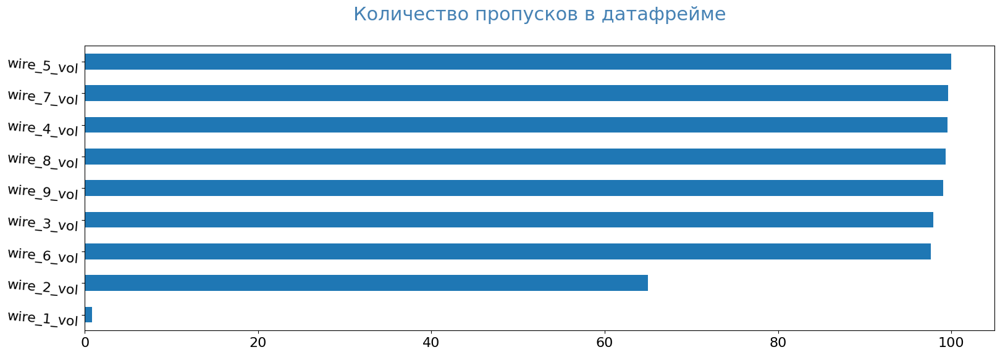

In [71]:
pass_value_barh(data_wire)

Заполняем пропуски нулями, т.к. 0 означает, что легирующая добавка не была добавлена в сплав.

In [72]:
data_wire[['wire_1_vol',
           'wire_2_vol',
           'wire_3_vol',
           'wire_4_vol',
           'wire_5_vol',
           'wire_6_vol',
           'wire_7_vol',
           'wire_8_vol',
           'wire_9_vol']] = data_wire[['wire_1_vol',
                                       'wire_2_vol',
                                       'wire_3_vol',
                                       'wire_4_vol',
                                       'wire_5_vol',
                                       'wire_6_vol',
                                       'wire_7_vol',
                                       'wire_8_vol',
                                       'wire_9_vol']].fillna(0)

пропусков не осталось :) 


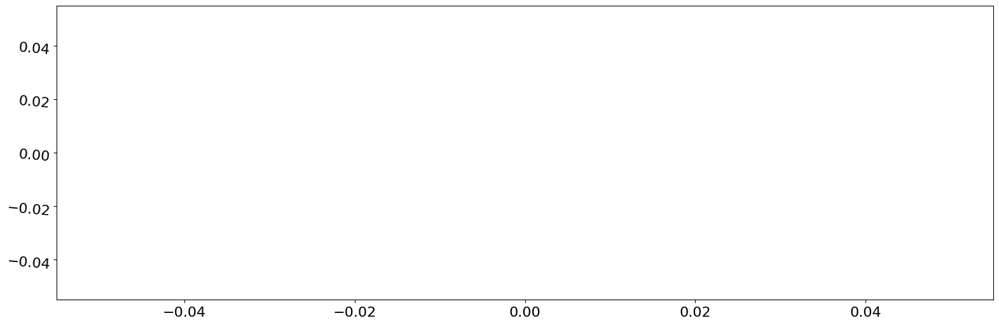

In [73]:
pass_value_barh(data_wire)

Аналогично поступим с сыпучими добавками:

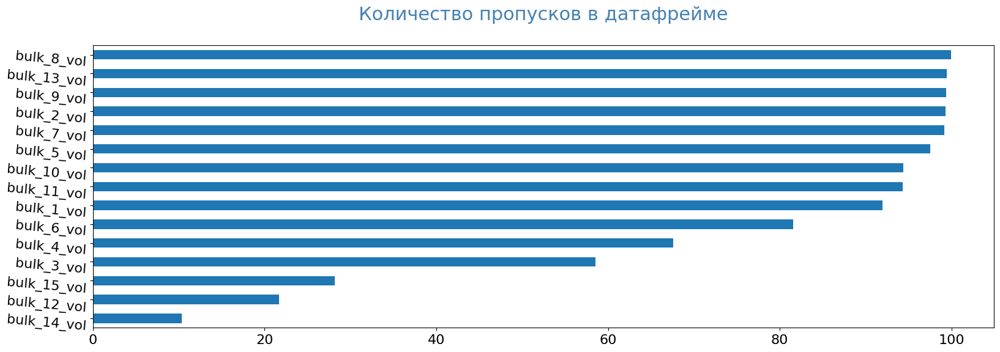

In [74]:
pass_value_barh(data_bulk)

In [75]:
data_bulk[['bulk_1_vol',
           'bulk_2_vol',
           'bulk_3_vol',
           'bulk_4_vol',
           'bulk_5_vol',
           'bulk_6_vol',
           'bulk_7_vol',
           'bulk_8_vol',
           'bulk_9_vol',
           'bulk_10_vol',
           'bulk_11_vol',
           'bulk_12_vol',
           'bulk_13_vol',
           'bulk_14_vol',
           'bulk_15_vol']] = data_bulk[['bulk_1_vol',
                                        'bulk_2_vol',
                                        'bulk_3_vol',
                                        'bulk_4_vol',
                                        'bulk_5_vol',
                                        'bulk_6_vol',
                                        'bulk_7_vol',
                                        'bulk_8_vol',
                                        'bulk_9_vol',
                                        'bulk_10_vol',
                                        'bulk_11_vol',
                                        'bulk_12_vol',
                                        'bulk_13_vol',
                                        'bulk_14_vol',
                                        'bulk_15_vol']].fillna(0)

пропусков не осталось :) 


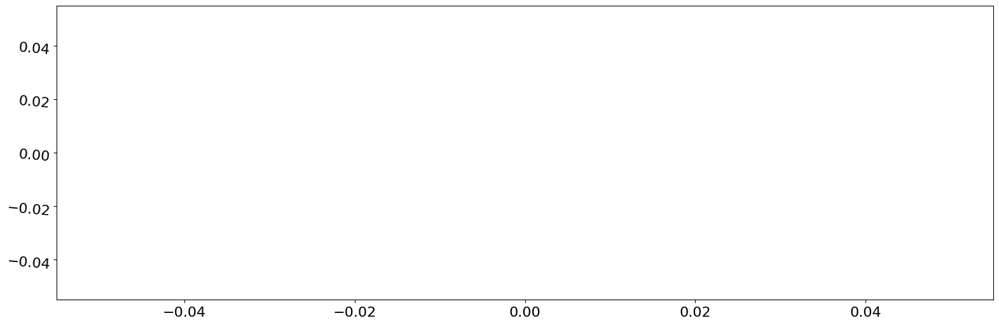

In [76]:
pass_value_barh(data_bulk)

### Удаление партий с tпл < 1350C

Удаляем информацию по партиям, где температура плавления указана ниже [+1350 С](http://thermalinfo.ru/svojstva-materialov/metally-i-splavy/temperatura-plavleniya-i-kipeniya-metallov-plotnost-i-teploprovodnost#:~:text=Температура%20плавления%20стали%20находится%20в%20диапазоне%20от%201350%20до%201535°С.)

In [77]:
data_temp = data_temp[data_temp.key != data_temp.loc[data_temp['temperature'] < 1350, 'key'].values[0]]

In [78]:
data_temp_size = data_temp.shape[0]
print(f'Исходное количество строк: {data_temp_orig_size}')
print(f'Количество строк после предобработки: {data_temp_size}')
print(f'Удалено: {round(100 - data_temp_size*100/data_temp_orig_size, 2)}%')

Исходное количество строк: 18092
Количество строк после предобработки: 18084
Удалено: 0.04%


### Добавление новых признаков data_arc

Cоздадим новые признаки в data_arc:

In [79]:
data_arc.head(3)

,key,arc_heating_start,arc_heating_end,active_power,reactive_power
0,1,2019-05-03 11:02:14,2019-05-03 11:06:02,0.305130,0.211253
1,1,2019-05-03 11:07:28,2019-05-03 11:10:33,0.765658,0.477438
2,1,2019-05-03 11:11:44,2019-05-03 11:14:36,0.580313,0.430460


In [80]:
data_arc['total_power'] = np.sqrt(data_arc.active_power**2 + data_arc.reactive_power**2)

In [81]:
data_arc.head(3)

,key,arc_heating_start,arc_heating_end,active_power,reactive_power,total_power
0,1,2019-05-03 11:02:14,2019-05-03 11:06:02,0.305130,0.211253,0.371123
1,1,2019-05-03 11:07:28,2019-05-03 11:10:33,0.765658,0.477438,0.902319
2,1,2019-05-03 11:11:44,2019-05-03 11:14:36,0.580313,0.430460,0.722536


In [82]:
data_arc['heating_duration'] = data_arc.arc_heating_end - data_arc.arc_heating_start
data_arc['heating_duration_sec'] = data_arc.heating_duration.apply(lambda x: x.total_seconds())
data_arc['cos_phi'] = data_arc.active_power / data_arc.total_power #коэффициент мощности
data_arc['work'] = data_arc.active_power * data_arc.heating_duration_sec

In [83]:
data_arc.head(3)

,key,arc_heating_start,arc_heating_end,active_power,reactive_power,total_power,heating_duration,heating_duration_sec,cos_phi,work
0,1,2019-05-03 11:02:14,2019-05-03 11:06:02,0.305130,0.211253,0.371123,0 days 00:03:48,228.0,0.822181,69.569640
1,1,2019-05-03 11:07:28,2019-05-03 11:10:33,0.765658,0.477438,0.902319,0 days 00:03:05,185.0,0.848545,141.646730
2,1,2019-05-03 11:11:44,2019-05-03 11:14:36,0.580313,0.430460,0.722536,0 days 00:02:52,172.0,0.803161,99.813836


### Агрегация датафреймов и удаление пропусков конечных температур

Напишем функцию агрегации датафреймов по ключу `key`. Их мы и будем агрегировать:

In [84]:
def agg_by_key(df, cols_to_sum, cols_to_agg, key='key'):
    """
    Агрегирует значения столбцов cols_to_sum и cols_to_agg датафрейма df по ключу key.
    Возвращает новый датафрейм с агрегированными данными.
    """
    agg_dict = {}
    for col in cols_to_sum:
        agg_dict[col] = 'sum'
    for col, agg_fn in cols_to_agg:
        agg_dict[col] = agg_fn
    return df.groupby(key).agg(agg_dict).reset_index()

Еще раз проверим, в каких таблицах у нас по несколько итераций для каждой партии:

In [85]:
def count_duplicate_keys(dfs):
    """
    Возвращает словарь, в котором ключи - это имена датафреймов, а значения - 
    количество уникальных значений столбца 'key', 
    для которых data.series.value_counts() > 1.
    """
    result = {}

    for i, df in enumerate(dfs):
        counts = df['key'].value_counts()
        count_duplicate = len(counts[counts > 1].index)
        df_name = str([name for name in globals() if globals()[name] is df][0])
        result[df_name] = count_duplicate

    return result

In [86]:
dfs = [data_arc, 
       data_bulk, 
       data_bulk_time, 
       data_gas, 
       data_temp, 
       data_wire, 
       data_wire_time
      ]

result = count_duplicate_keys(dfs)
for key, value in result.items():
    print(f'{key}: {value}')

data_arc: 3174
data_bulk: 0
data_bulk_time: 0
data_gas: 0
data_temp: 3213
data_wire: 0
data_wire_time: 0


Значит по партиям key будем агрегировать только `data_arc` и `data_temp`.

In [87]:
data_arc.columns

Index(['key', 'arc_heating_start', 'arc_heating_end', 'active_power',
       'reactive_power', 'total_power', 'heating_duration',
       'heating_duration_sec', 'cos_phi', 'work'],
      dtype='object')

In [88]:
data_arc_agg = agg_by_key(data_arc, ['active_power', 
                                     'reactive_power', 
                                     'total_power', 
                                     'heating_duration', 
                                     'heating_duration_sec',
                                     'cos_phi',
                                     'work'
                                    ], 
                                    [('arc_heating_start', 'min'), 
                                     ('arc_heating_end', 'max')
                                    ]
                         )

In [89]:
data_arc_agg = data_arc_agg.rename(columns={'active_power':'active_power_sum', 
                                            'reactive_power':'reactive_power_sum', 
                                            'total_power':'total_power_sum', 
                                            'heating_duration':'heating_duration_sum', 
                                            'heating_duration_sec':'heating_duration_sec_sum',
                                            'cos_phi':'cos_phi_sum',
                                            'work':'work_sum',
                                            'arc_heating_start':'arc_heating_start_min',
                                            'arc_heating_end':'arc_heating_end_max'}
                                  )

In [90]:
data_arc_agg.head()

,key,active_power_sum,reactive_power_sum,total_power_sum,heating_duration_sum,heating_duration_sec_sum,cos_phi_sum,work_sum,arc_heating_start_min,arc_heating_end_max
0,1,3.036730,2.142821,3.718736,0 days 00:18:18,1098.0,4.083428,628.616930,2019-05-03 11:02:14,2019-05-03 11:28:37
1,2,2.139408,1.453357,2.588349,0 days 00:13:31,811.0,3.301105,395.281800,2019-05-03 11:34:14,2019-05-03 11:53:18
2,3,4.063641,2.937457,5.019223,0 days 00:10:55,655.0,4.048621,581.774624,2019-05-03 12:06:54,2019-05-03 12:32:19
3,4,2.706489,2.056992,3.400038,0 days 00:12:21,741.0,3.175691,543.710274,2019-05-03 12:39:37,2019-05-03 12:57:50
4,5,2.252950,1.687991,2.816980,0 days 00:14:29,869.0,3.187274,412.180480,2019-05-03 13:11:13,2019-05-03 13:33:55


In [91]:
data_temp.isna().sum()

key                 0
sampling_time       0
temperature      3427
dtype: int64

In [92]:
def aggregate_data(df):
    grouped = df.sort_values('sampling_time').groupby('key')
    
    first_temps = []
    last_temps = []
    first_times = []
    last_times = []
    key_counts = []
    timedelta_means = []
    
    for name, group in grouped:
        
        first_temp = group.loc[group['sampling_time'].idxmin(), 'temperature']
        last_temp = group.loc[group['sampling_time'].idxmax(), 'temperature']

        first_time = group['sampling_time'].iloc[0]
        last_time = group['sampling_time'].iloc[-1]

        key_count = len(group)
        time_deltas = group['sampling_time'].diff().dropna()
        timedelta_mean = time_deltas.mean().total_seconds()
        
        first_temps.append(first_temp)
        last_temps.append(last_temp)
        first_times.append(first_time)
        last_times.append(last_time)
        key_counts.append(key_count)
        timedelta_means.append(timedelta_mean)
    
    agg_data = pd.DataFrame({
        'key': grouped.groups.keys(),
        'first_temperature': first_temps,
        'last_temperature': last_temps,
        'first_sampling_time': first_times,
        'last_sampling_time': last_times,
        'iterations_count': key_counts,
        'timedelta_mean': timedelta_means
    })
    
    agg_data = agg_data[['key', 'first_sampling_time', 'last_sampling_time', 'first_temperature', 'last_temperature', 'iterations_count', 'timedelta_mean']]
    
    return agg_data

In [93]:
data_temp_agg = aggregate_data(data_temp)

In [94]:
data_temp_agg.head(3)

,key,first_sampling_time,last_sampling_time,first_temperature,last_temperature,iterations_count,timedelta_mean
0,1,2019-05-03 11:02:04,2019-05-03 11:30:38,1571.0,1613.0,6,342.80
1,2,2019-05-03 11:34:04,2019-05-03 11:55:09,1581.0,1602.0,5,316.25
2,3,2019-05-03 12:06:44,2019-05-03 12:35:57,1596.0,1599.0,6,350.60


In [95]:
print(f'Всего ключей: {data_temp_agg.shape[0]}')
print()
print(f'Пропуски значений по столбцам:')
data_temp_agg.isna().sum()

Всего ключей: 3215

Пропуски значений по столбцам:


key                      0
first_sampling_time      0
last_sampling_time       0
first_temperature        0
last_temperature       739
iterations_count         0
timedelta_mean           2
dtype: int64

Удалим ключи, где не указана конечная температура плавления сплава и средняя продолжительность итераций:

In [96]:
data_temp_agg = data_temp_agg.dropna(subset=['last_temperature','timedelta_mean'])

In [97]:
print(f'Всего ключей: {data_temp_agg.shape[0]}')
print()
print(f'Пропуски значений по столбцам:')
data_temp_agg.isna().sum()

Всего ключей: 2474

Пропуски значений по столбцам:


key                    0
first_sampling_time    0
last_sampling_time     0
first_temperature      0
last_temperature       0
iterations_count       0
timedelta_mean         0
dtype: int64

Еще раз проверяем количество повторений ключей в каждой таблице:

In [98]:
dfs = [data_arc_agg, 
       data_bulk, 
       data_bulk_time, 
       data_gas, 
       data_temp_agg, 
       data_wire, 
       data_wire_time
      ]

result = count_duplicate_keys(dfs)
for key, value in result.items():
    print(f'{key}: {value}')

data_arc_agg: 0
data_bulk: 0
data_bulk_time: 0
data_gas: 0
data_temp_agg: 0
data_wire: 0
data_wire_time: 0


Теперь можем объединять таблицы.

### Объединение таблиц

Объединим таблицы по номерам партий `key` методом inner, чтобы в итоговый датафрейм попала информация только по партиям, по которым есть все данные во всех таблицах:

In [99]:
def merge_dataframes(df_list):
    for df in df_list:
        if 'key' not in df.columns:
            raise ValueError('Dataframe is missing "key" column')

    merged_df = pd.merge(df_list[0], df_list[1], on='key', how='inner')
    for i in range(2, len(df_list)):
        merged_df = pd.merge(merged_df, df_list[i], on='key', how='inner')
    
    return merged_df

In [100]:
data = merge_dataframes(dfs)
data = data.drop(columns='heating_duration_sum')
data.set_index('key', inplace=True)
data.tail()

,active_power_sum,reactive_power_sum,total_power_sum,heating_duration_sec_sum,cos_phi_sum,work_sum,arc_heating_start_min,arc_heating_end_max,bulk_1_vol,bulk_2_vol,...,wire_9_vol,wire_1_time,wire_2_time,wire_3_time,wire_4_time,wire_5_time,wire_6_time,wire_7_time,wire_8_time,wire_9_time
key,,,,,,,,,,,,,,,,,,,,,
2495,3.168133,2.210936,3.868721,723.0,3.250906,571.539318,2019-08-10 11:27:57,2019-08-10 11:48:05,0.0,0.0,...,0.0,2019-08-10 11:31:40,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT
2496,4.174918,2.872031,5.070316,940.0,4.917636,675.222467,2019-08-10 11:56:58,2019-08-10 12:23:07,0.0,0.0,...,0.0,2019-08-10 11:59:10,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT
2497,3.605239,2.452092,4.360918,569.0,2.482839,680.326674,2019-08-10 12:37:36,2019-08-10 12:51:20,0.0,0.0,...,0.0,2019-08-10 12:46:10,2019-08-10 12:40:30,NaT,NaT,NaT,NaT,NaT,NaT,NaT
2498,3.202310,2.239820,3.909917,750.0,4.096223,474.918795,2019-08-10 12:58:21,2019-08-10 13:20:59,0.0,0.0,...,0.0,2019-08-10 13:02:54,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT
2499,1.737084,1.296836,2.169252,883.0,3.203129,427.922553,2019-08-10 13:33:31,2019-08-10 13:56:17,0.0,0.0,...,0.0,2019-08-10 13:45:26,2019-08-10 13:38:56,NaT,NaT,NaT,NaT,NaT,NaT,NaT


In [101]:
data.shape

(2327, 63)

In [102]:
data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 2327 entries, 1 to 2499
Data columns (total 63 columns):
 #   Column                    Non-Null Count  Dtype         
---  ------                    --------------  -----         
 0   active_power_sum          2327 non-null   float64       
 1   reactive_power_sum        2327 non-null   float64       
 2   total_power_sum           2327 non-null   float64       
 3   heating_duration_sec_sum  2327 non-null   float64       
 4   cos_phi_sum               2327 non-null   float64       
 5   work_sum                  2327 non-null   float64       
 6   arc_heating_start_min     2327 non-null   datetime64[ns]
 7   arc_heating_end_max       2327 non-null   datetime64[ns]
 8   bulk_1_vol                2327 non-null   float64       
 9   bulk_2_vol                2327 non-null   float64       
 10  bulk_3_vol                2327 non-null   float64       
 11  bulk_4_vol                2327 non-null   float64       
 12  bulk_5_vol          

In [103]:
data.gas.head()

key
1    29.749986
2    12.555561
3    28.554793
4    18.841219
5     5.413692
Name: gas, dtype: float64

Из 3239 ключей у нас осталось 2327 - удалено 28% данных.

### Разделение на выборки

Разделим получившийся датасет на обучающую и тестовую выборки в соотношении 3:1. Целевая переменная - конечная температура сплава по всей партии `last_temperature`. Валидационную выборку отдельно не выделяем, т.к. кросс-валидация будет идти внутри RandomizedSearchCV.

In [104]:
data_train, data_test = train_test_split(data, test_size=0.25, random_state=RANDOM_STATE)
data_train.shape[0], data_test.shape[0], data.shape[0]

(1745, 582, 2327)

### Обработка пропусков

In [105]:
data_train.head(3)

,active_power_sum,reactive_power_sum,total_power_sum,heating_duration_sec_sum,cos_phi_sum,work_sum,arc_heating_start_min,arc_heating_end_max,bulk_1_vol,bulk_2_vol,...,wire_9_vol,wire_1_time,wire_2_time,wire_3_time,wire_4_time,wire_5_time,wire_6_time,wire_7_time,wire_8_time,wire_9_time
key,,,,,,,,,,,,,,,,,,,,,
1292,3.631177,2.572795,4.453397,1073.0,4.876022,660.041645,2019-06-21 04:56:30,2019-06-21 05:49:06,0.0,0.0,...,0.0,2019-06-21 05:08:56,2019-06-21 04:58:26,NaT,NaT,NaT,NaT,NaT,NaT,NaT
2211,2.772406,2.112015,3.486397,1122.0,4.003950,615.941532,2019-07-31 04:40:31,2019-07-31 05:06:52,0.0,0.0,...,0.0,2019-07-31 04:58:53,NaT,NaT,NaT,NaT,NaT,NaT,NaT,NaT
1768,1.451485,1.000660,1.763346,274.0,1.655153,227.513741,2019-07-08 06:03:00,2019-07-08 06:16:13,0.0,0.0,...,0.0,2019-07-08 06:16:23,2019-07-08 06:04:32,NaT,NaT,NaT,NaT,NaT,NaT,NaT


Проверим количество уникальных значений по столбцам:

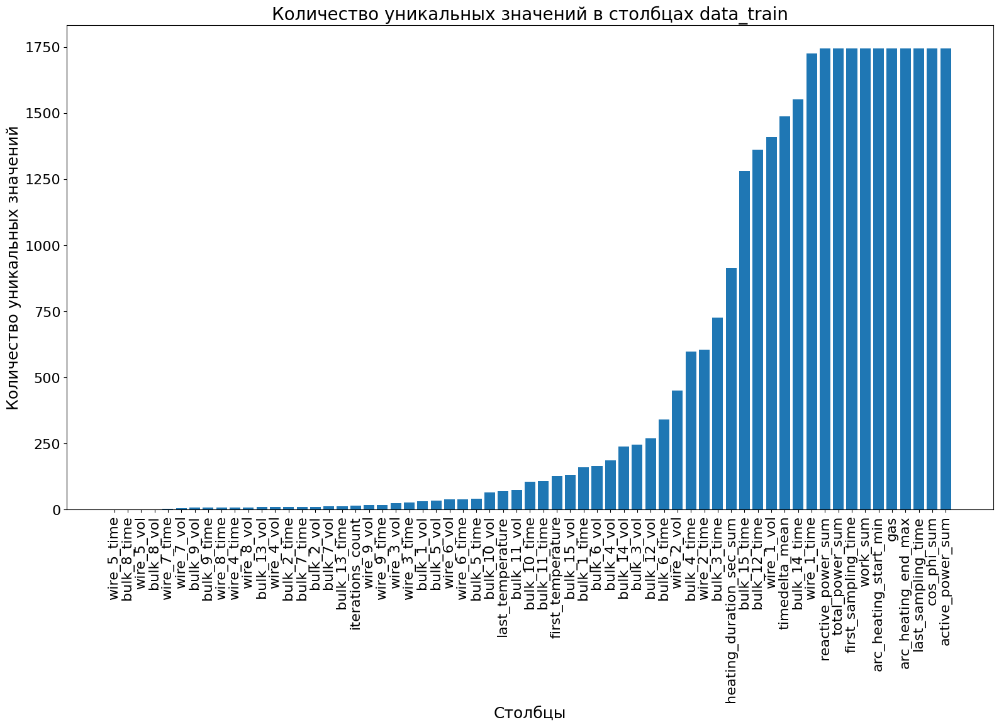

In [106]:
unique_vals = data_train.nunique().sort_values()

plt.figure(figsize=(19,10))
plt.bar(unique_vals.index, unique_vals.values)
plt.xlabel('Столбцы', fontsize=18)
plt.xticks(rotation=90, fontsize=16)
plt.ylabel('Количество уникальных значений', fontsize=18)
plt.yticks(fontsize=16)
plt.title('Количество уникальных значений в столбцах data_train', fontsize=20)
plt.show()

In [107]:
print(data_train.nunique().sort_values().head())

wire_5_time    0
bulk_8_time    0
wire_5_vol     1
bulk_8_vol     1
wire_7_time    4
dtype: int64


Удалим столбцы с информацией о bulk_8 и wire_5, т.к. они содержат по одному уникальному значению объема и не содержат данных по времени, чего недостаточно для модели, чтобы на основании этого сделать корректные выводы. Удаляем данные столбцы сразу во обоих выборках - обучающей и тестовой.

In [108]:
data_train = data_train.drop(columns = ['bulk_8_time','wire_5_time','wire_5_vol','bulk_8_vol'])
data_train.head(3)

,active_power_sum,reactive_power_sum,total_power_sum,heating_duration_sec_sum,cos_phi_sum,work_sum,arc_heating_start_min,arc_heating_end_max,bulk_1_vol,bulk_2_vol,...,wire_8_vol,wire_9_vol,wire_1_time,wire_2_time,wire_3_time,wire_4_time,wire_6_time,wire_7_time,wire_8_time,wire_9_time
key,,,,,,,,,,,,,,,,,,,,,
1292,3.631177,2.572795,4.453397,1073.0,4.876022,660.041645,2019-06-21 04:56:30,2019-06-21 05:49:06,0.0,0.0,...,0.0,0.0,2019-06-21 05:08:56,2019-06-21 04:58:26,NaT,NaT,NaT,NaT,NaT,NaT
2211,2.772406,2.112015,3.486397,1122.0,4.003950,615.941532,2019-07-31 04:40:31,2019-07-31 05:06:52,0.0,0.0,...,0.0,0.0,2019-07-31 04:58:53,NaT,NaT,NaT,NaT,NaT,NaT,NaT
1768,1.451485,1.000660,1.763346,274.0,1.655153,227.513741,2019-07-08 06:03:00,2019-07-08 06:16:13,0.0,0.0,...,0.0,0.0,2019-07-08 06:16:23,2019-07-08 06:04:32,NaT,NaT,NaT,NaT,NaT,NaT


In [109]:
data_test = data_test.drop(columns = ['bulk_8_time','wire_5_time','wire_5_vol','bulk_8_vol'])

Теперь проверим пропуски в данных в обучающей выборке:

In [110]:
def pass_value_share_barh(df):
    try:
        prop = df.isna().sum() * 100 / len(df)
        (
            prop
            .to_frame()
            .rename(columns={0: 'prop'})
            .query('prop > 0')
            .sort_values(by='prop', ascending=True)
            .plot(kind='barh', figsize=(19, 15), legend=False, fontsize=16)
        )
        plt.title('Доля пропусков по столбцам датафрейма', fontsize=18)
        plt.xlabel("Доля пропусков, %", fontsize=16)
        plt.ylabel('Столбцы', fontsize=16)
    except:
        print('Столбцы без пропусков')

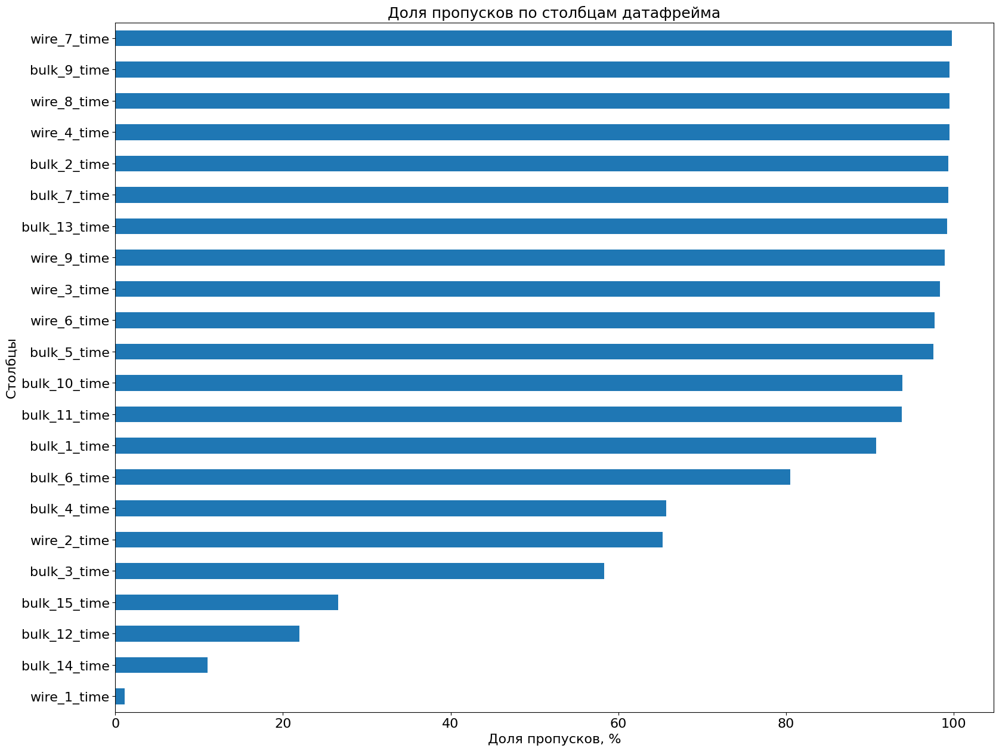

In [111]:
pass_value_share_barh(data_train)

У нас остались пропуски только в столбцах со временем добавления легирующего материала. Было бы интересно посмотреть, коррелирует ли время добавления легирующего материала с конечной температурой сплава. Но использовать, например, корреляцию Пирсона для проверки корреляции значений типа datetime с числовой переменной нельзя. Т.к. наша задача не является задачей временного ряда, восстанавливать мы его не будем, пропусков по переменным типа datetime очень много - удалим данные признаки из датасета, чтобы модель не искала несуществующие зависимости по неполным данным.

In [112]:
data_train = data_train.drop(columns = ['wire_1_time', 
                                        'wire_2_time',
                                        'wire_3_time',
                                        'wire_4_time',
                                        'wire_6_time',
                                        'wire_7_time',
                                        'wire_8_time',
                                        'wire_9_time',
                                        'bulk_1_time',
                                        'bulk_2_time',
                                        'bulk_3_time',
                                        'bulk_4_time',
                                        'bulk_5_time',
                                        'bulk_6_time',
                                        'bulk_7_time',
                                        'bulk_9_time',
                                        'bulk_10_time',
                                        'bulk_11_time',
                                        'bulk_12_time',
                                        'bulk_13_time',
                                        'bulk_14_time',
                                        'bulk_15_time'])
data_train.head(3)

,active_power_sum,reactive_power_sum,total_power_sum,heating_duration_sec_sum,cos_phi_sum,work_sum,arc_heating_start_min,arc_heating_end_max,bulk_1_vol,bulk_2_vol,...,iterations_count,timedelta_mean,wire_1_vol,wire_2_vol,wire_3_vol,wire_4_vol,wire_6_vol,wire_7_vol,wire_8_vol,wire_9_vol
key,,,,,,,,,,,,,,,,,,,,,
1292,3.631177,2.572795,4.453397,1073.0,4.876022,660.041645,2019-06-21 04:56:30,2019-06-21 05:49:06,0.0,0.0,...,7,566.333333,234.374405,5.127200,0.0,0.0,0.0,0.0,0.0,0.0
2211,2.772406,2.112015,3.486397,1122.0,4.003950,615.941532,2019-07-31 04:40:31,2019-07-31 05:06:52,0.0,0.0,...,6,341.200000,50.144642,0.000000,0.0,0.0,0.0,0.0,0.0,0.0
1768,1.451485,1.000660,1.763346,274.0,1.655153,227.513741,2019-07-08 06:03:00,2019-07-08 06:16:13,0.0,0.0,...,3,646.000000,57.142796,63.366158,0.0,0.0,0.0,0.0,0.0,0.0


Столбцы без пропусков


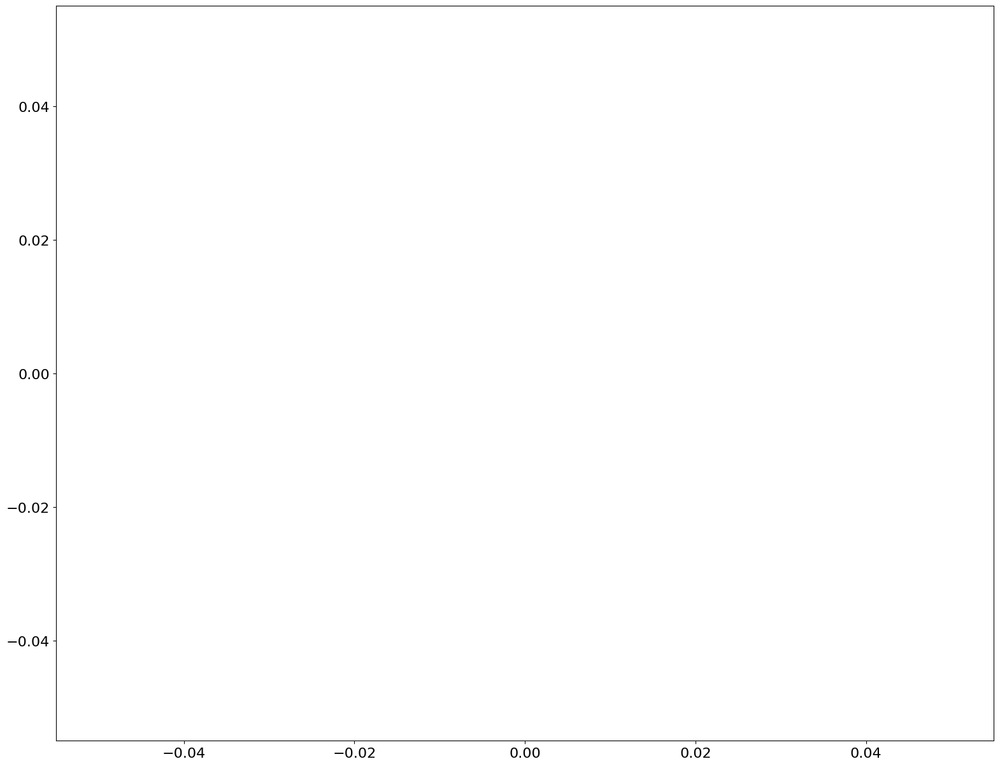

In [113]:
pass_value_share_barh(data_train)

In [114]:
data_test = data_test.drop(columns = ['wire_1_time', 
                                      'wire_2_time',
                                      'wire_3_time',
                                      'wire_4_time',
                                      'wire_6_time',
                                      'wire_7_time',
                                      'wire_8_time',
                                      'wire_9_time',
                                      'bulk_1_time',
                                      'bulk_2_time',
                                      'bulk_3_time',
                                      'bulk_4_time',
                                      'bulk_5_time',
                                      'bulk_6_time',
                                      'bulk_7_time',
                                      'bulk_9_time',
                                      'bulk_10_time',
                                      'bulk_11_time',
                                      'bulk_12_time',
                                      'bulk_13_time',
                                      'bulk_14_time',
                                      'bulk_15_time'])
data_test.head(3)

,active_power_sum,reactive_power_sum,total_power_sum,heating_duration_sec_sum,cos_phi_sum,work_sum,arc_heating_start_min,arc_heating_end_max,bulk_1_vol,bulk_2_vol,...,iterations_count,timedelta_mean,wire_1_vol,wire_2_vol,wire_3_vol,wire_4_vol,wire_6_vol,wire_7_vol,wire_8_vol,wire_9_vol
key,,,,,,,,,,,,,,,,,,,,,
1752,5.467457,4.097562,6.838385,1293.0,5.635715,1081.644538,2019-07-07 14:58:43,2019-07-07 15:42:53,0.0,0.0,...,8,412.285714,91.166397,0.000,0.0,0.0,0.0,0.0,0.0,0.0
416,4.325758,2.987211,5.258334,1797.0,4.928720,1405.158405,2019-05-19 08:44:58,2019-05-19 09:43:22,0.0,0.0,...,7,642.500000,112.132797,21.112,0.0,0.0,0.0,0.0,0.0,0.0
1793,1.403108,1.037128,1.745152,333.0,2.413413,154.548580,2019-07-09 00:16:10,2019-07-09 00:39:12,0.0,0.0,...,4,638.666666,117.093597,0.000,0.0,0.0,0.0,0.0,0.0,0.0


Столбцы без пропусков


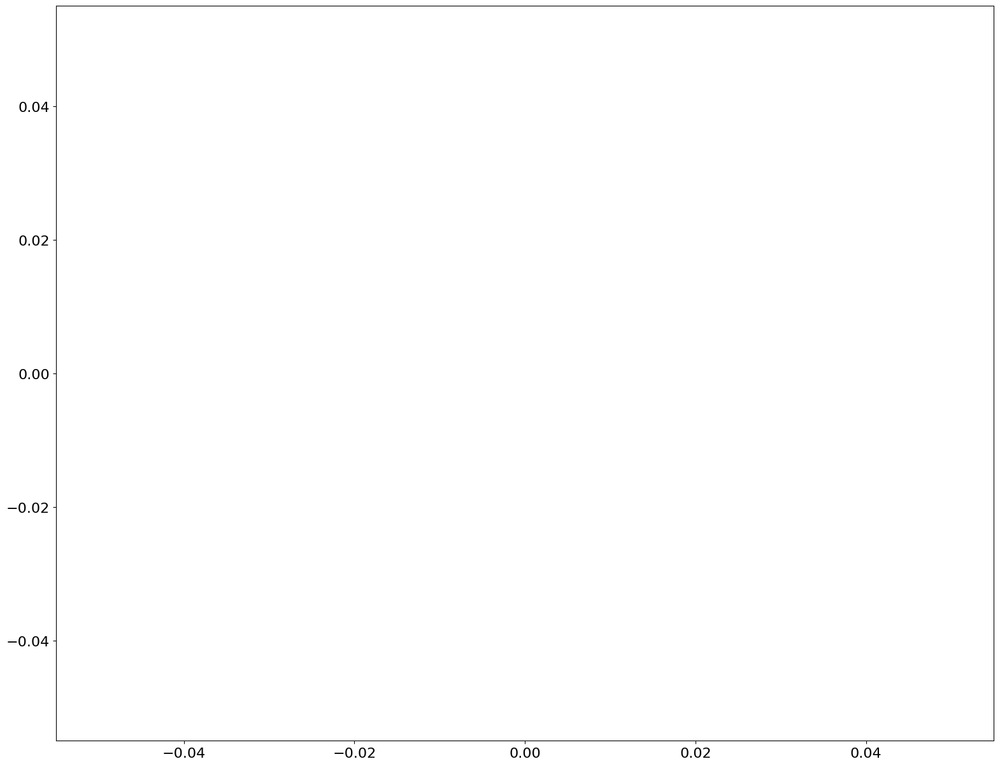

In [115]:
pass_value_share_barh(data_test)

### Проверка корреляции признаков

Построим тепловую карту для матрицы корреляции Пирсона для всех числовых значений датасета.

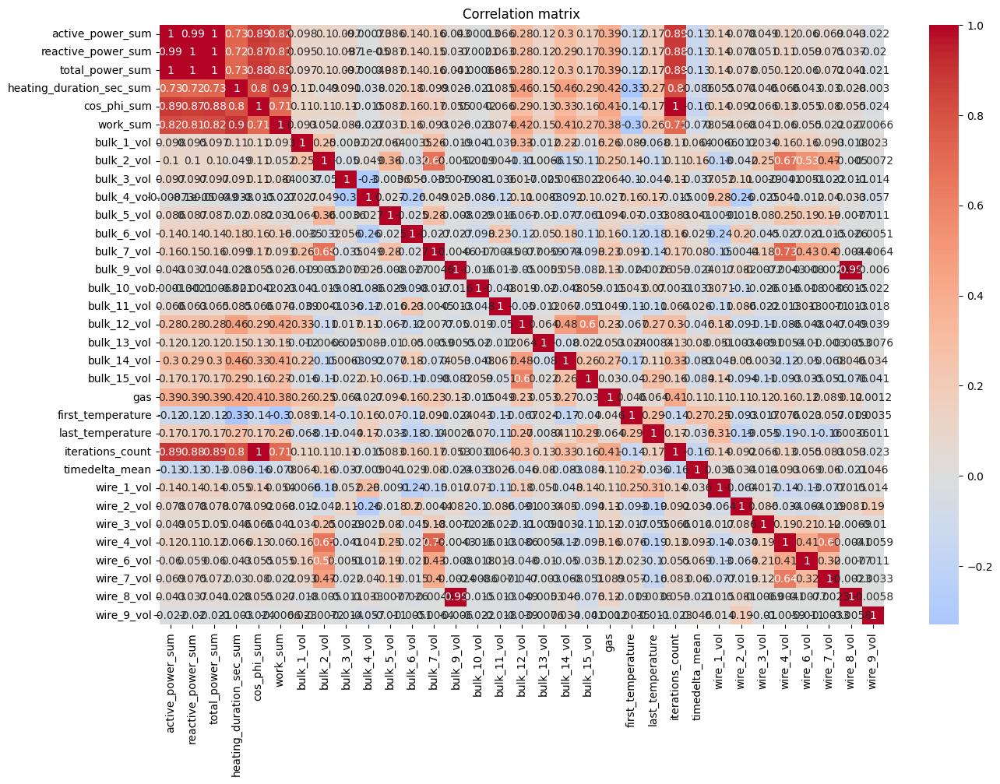

In [116]:
corr_matrix_raw = data_train.corr(method='pearson')

fig, ax1 = plt.subplots(nrows=1, ncols=1, figsize=(15, 10))
sns.heatmap(corr_matrix_raw, annot=True, cmap='coolwarm', center=0, ax=ax1, annot_kws={"fontsize":10})
ax1.set_title('Correlation matrix')
plt.show()

Интересно, что, bulk_9_vol и wire_8_vol имеют коэффициент корреляции = 0.9 (и при этом больше всего пропусков времени мы имеем как раз по этим добавкам). На втором месте по силе корреляции находятся bulk_12_vol и bulk_15_vol, а также bulk_2_vol и wire_4_vol - 0.6. По ним же наоборот пропусков почти меньше всего.  

Проверим Phik корреляцию, у которой нет таких строгих предположений о том, что переменные распределены нормально и однородны. Она способна улавливать нелинейные взаимосвязи, которые будут моделироваться в линейной регрессии немного иначе в зависимости от характера взаимосвязи (то есть ели phik обнаруживает какую-то более сильную взаимосвязь, чем линейный corr, значит есть смысл изучить характер взаимосвязи подробнее и постараться его учесть при моделировании).

interval columns not set, guessing: ['active_power_sum', 'reactive_power_sum', 'total_power_sum', 'heating_duration_sec_sum', 'cos_phi_sum', 'work_sum', 'bulk_1_vol', 'bulk_2_vol', 'bulk_3_vol', 'bulk_4_vol', 'bulk_5_vol', 'bulk_6_vol', 'bulk_7_vol', 'bulk_9_vol', 'bulk_10_vol', 'bulk_11_vol', 'bulk_12_vol', 'bulk_13_vol', 'bulk_14_vol', 'bulk_15_vol', 'gas', 'first_temperature', 'last_temperature', 'iterations_count', 'timedelta_mean', 'wire_1_vol', 'wire_2_vol', 'wire_3_vol', 'wire_4_vol', 'wire_6_vol', 'wire_7_vol', 'wire_8_vol', 'wire_9_vol']


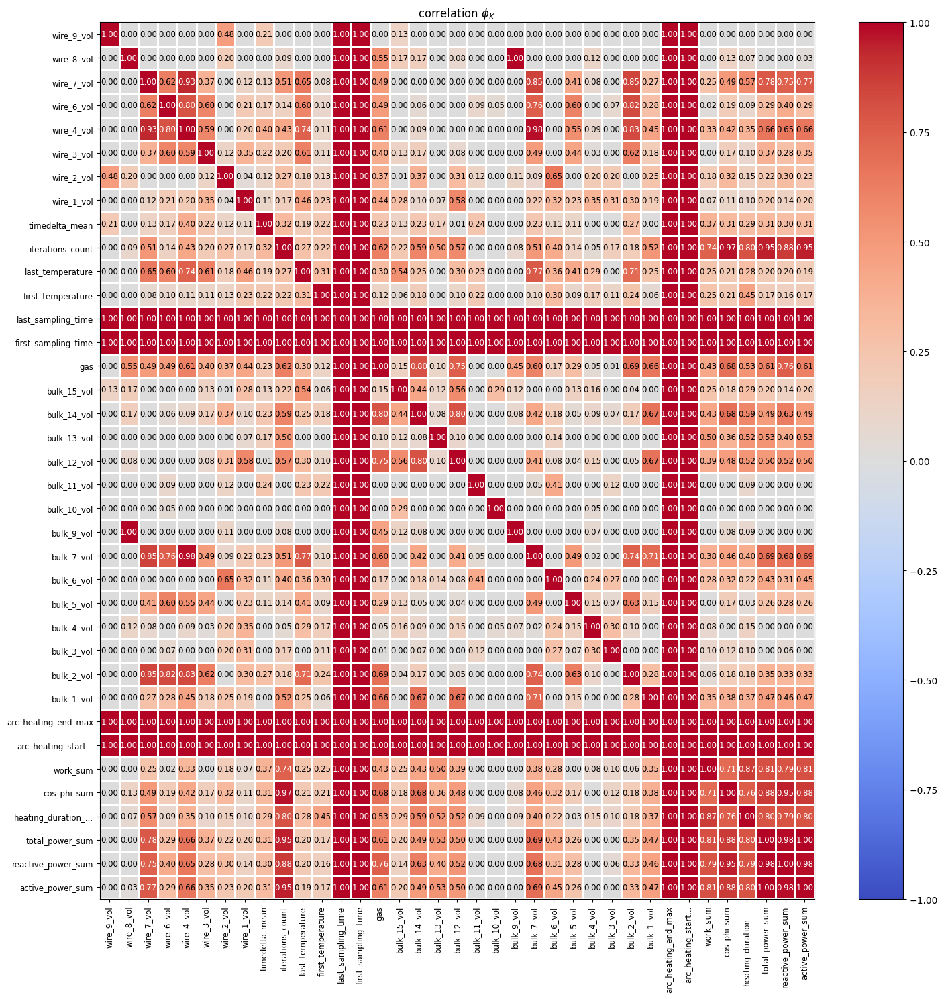

In [117]:
phik_overview = data_train.phik_matrix()

plot_correlation_matrix(phik_overview.values, 
                        x_labels=phik_overview.columns, 
                        y_labels=phik_overview.index, 
                        color_map='coolwarm', 
                        title=r'correlation $\phi_K$', 
                        fontsize_factor=0.85, 
                        figsize=(15, 15))
plt.tight_layout()

Посмотрим только на те столбцы, где коэффициент корреляции >=0.9:

In [118]:
def plot_phik_overview(dataframe):
    phik_overview = dataframe.phik_matrix()

    mask = phik_overview >= 0.9
    filtered_phik = np.where(mask, phik_overview, 0)
    selected_columns = phik_overview.columns[mask.any(axis=0)]

    figure, axes = plt.subplots(figsize=(10, 10))
    axes.matshow(filtered_phik, cmap='Pastel1_r')

    axes.set_xticks(np.arange(len(selected_columns)))
    axes.set_xticklabels(selected_columns, rotation=90)

    axes.set_yticks(np.arange(len(selected_columns)))
    axes.set_yticklabels(selected_columns)

    plt.title(r'correlation $\phi_K$ (filtered, >= 0.9)', fontsize=14)
    plt.tight_layout()
    plt.show()

interval columns not set, guessing: ['active_power_sum', 'reactive_power_sum', 'total_power_sum', 'heating_duration_sec_sum', 'cos_phi_sum', 'work_sum', 'bulk_1_vol', 'bulk_2_vol', 'bulk_3_vol', 'bulk_4_vol', 'bulk_5_vol', 'bulk_6_vol', 'bulk_7_vol', 'bulk_9_vol', 'bulk_10_vol', 'bulk_11_vol', 'bulk_12_vol', 'bulk_13_vol', 'bulk_14_vol', 'bulk_15_vol', 'gas', 'first_temperature', 'last_temperature', 'iterations_count', 'timedelta_mean', 'wire_1_vol', 'wire_2_vol', 'wire_3_vol', 'wire_4_vol', 'wire_6_vol', 'wire_7_vol', 'wire_8_vol', 'wire_9_vol']


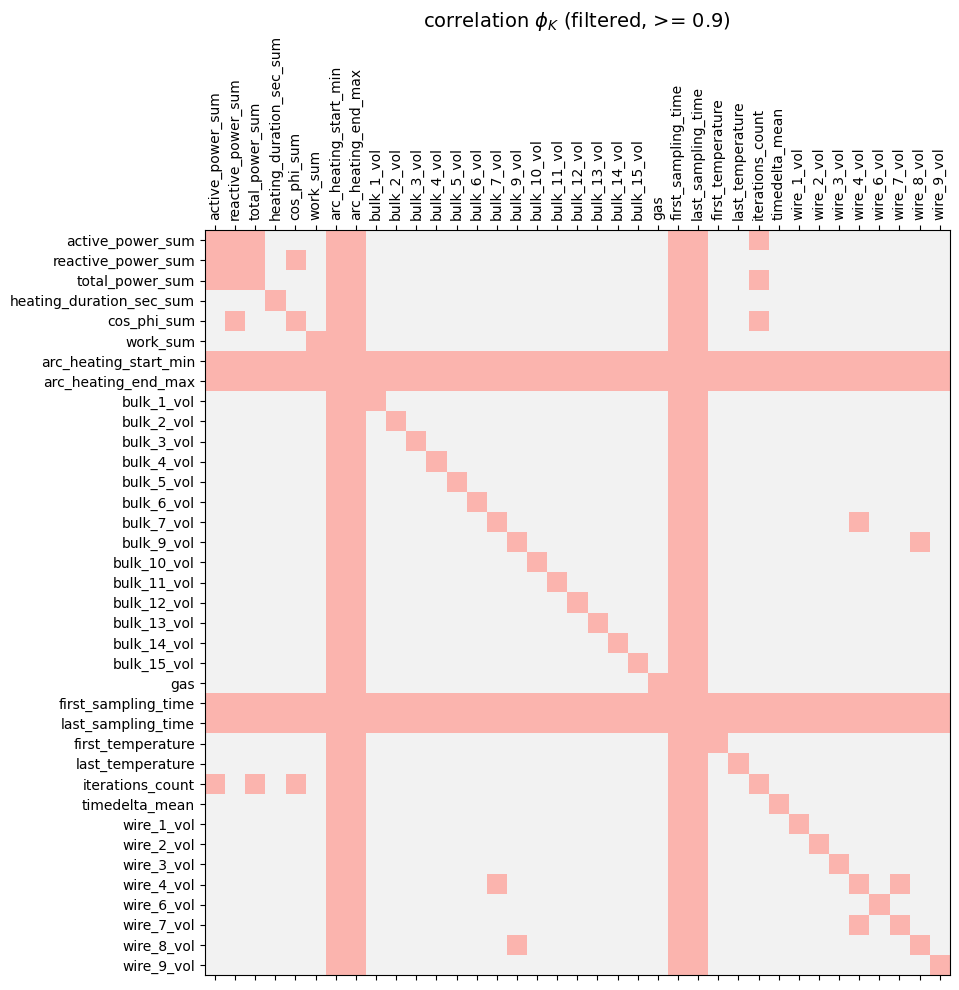

In [119]:
plot_phik_overview(data_train)

### Борьба с мультиколлинеарностью

Мультиколлинеарность может привести к неправильным оценкам параметров модели и уменьшению предсказательной способности модели. Поэтому удалим столбцы, которые сильно коррелируют между собой. Удалять их будем как в обучающей, так и в тестовой выборках, чтобы модель не искала на тесте взаимосвязь между ненужными признаками.

interval columns not set, guessing: ['total_power_sum', 'heating_duration_sec_sum', 'cos_phi_sum', 'work_sum', 'bulk_1_vol', 'bulk_2_vol', 'bulk_3_vol', 'bulk_4_vol', 'bulk_5_vol', 'bulk_6_vol', 'bulk_7_vol', 'bulk_9_vol', 'bulk_10_vol', 'bulk_11_vol', 'bulk_12_vol', 'bulk_13_vol', 'bulk_14_vol', 'bulk_15_vol', 'gas', 'first_temperature', 'last_temperature', 'timedelta_mean', 'wire_1_vol', 'wire_2_vol', 'wire_3_vol', 'wire_6_vol', 'wire_7_vol', 'wire_9_vol']


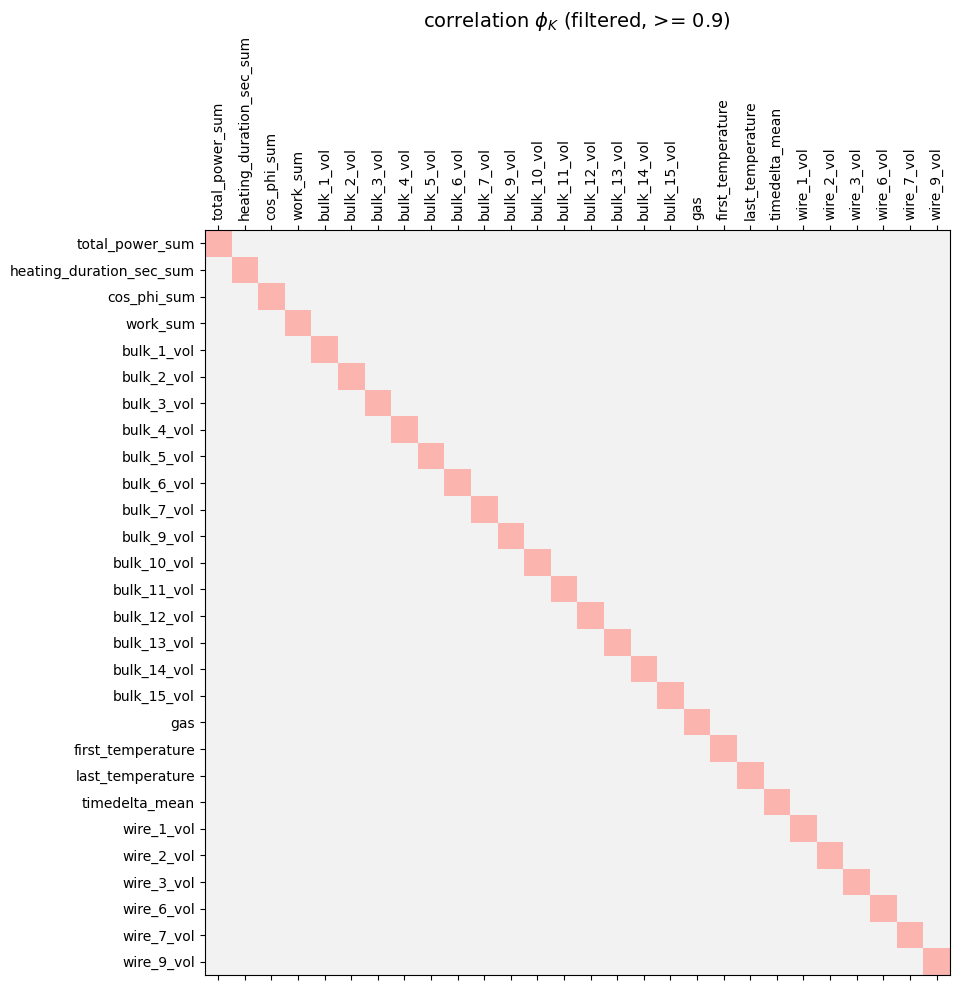

In [120]:
data_train = data_train.drop(columns = ['arc_heating_start_min',
                                        'arc_heating_end_max',
                                        'first_sampling_time',
                                        'last_sampling_time',
                                        'active_power_sum',
                                        'reactive_power_sum',
                                        'iterations_count',
                                        'wire_4_vol',
                                        'wire_8_vol'
                                       ]
                            )
plot_phik_overview(data_train)

In [121]:
data_test = data_test.drop(columns = ['arc_heating_start_min',
                                      'arc_heating_end_max',
                                      'first_sampling_time',
                                      'last_sampling_time',
                                      'active_power_sum',
                                      'reactive_power_sum',
                                      'iterations_count',
                                      'wire_4_vol',
                                      'wire_8_vol'
                                     ]
                            )

Теперь можем проверить распределение признаков и приступать к обучению моделей.

### Графики распределения признаков

Построим графики распределения признаков, сразу исключив нулевые значения (мы заполняли пропуски нулями поэтому очевидно, что в нуле будут выбросы). Посмотрим на распределение признаков за исключением нулевых значений:

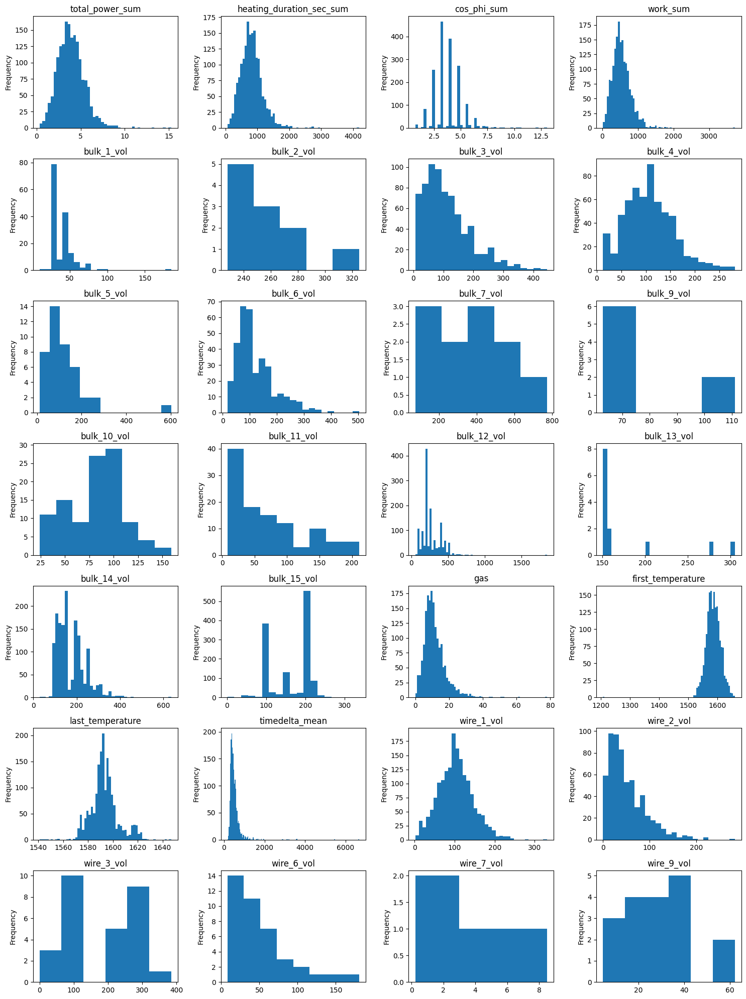

In [122]:
nrows = 7
ncols = 4
fig, axes = plt.subplots(nrows=nrows, ncols=ncols, figsize=(15, 20))

for i, feature in enumerate(data_train.columns):
    positive_data_train = data_train[feature][data_train[feature] > 0]
    row = i // ncols
    col = i % ncols 
    bins = np.histogram_bin_edges(positive_data_train, bins='auto')
    ax = axes[row, col]    
    positive_data_train.plot(kind='hist', ax=ax, title=feature, bins=bins)

plt.tight_layout()
plt.show()

В целом распределение нормальное, за исключением признаков, в которых мало значений (и больше нулей - объемы). Нулевые значения и другие выбросы удалять не будем, чтобы модель могла на них обучиться.

### Разделение данных на признаки и целевую переменную

Для начала проверим, одинаковое ли количество столбцов у нас осталось в data_train и data_test:

In [123]:
diff_cols = list(data_train.columns.symmetric_difference(data_test.columns))
print(", ".join(diff_cols))

In [124]:
features_train = data_train.drop('last_temperature', axis=1)
target_train = data_train['last_temperature']
features_test = data_test.drop('last_temperature', axis=1)
target_test = data_test['last_temperature']

In [125]:
features_train.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1745 entries, 1292 to 183
Data columns (total 27 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   total_power_sum           1745 non-null   float64
 1   heating_duration_sec_sum  1745 non-null   float64
 2   cos_phi_sum               1745 non-null   float64
 3   work_sum                  1745 non-null   float64
 4   bulk_1_vol                1745 non-null   float64
 5   bulk_2_vol                1745 non-null   float64
 6   bulk_3_vol                1745 non-null   float64
 7   bulk_4_vol                1745 non-null   float64
 8   bulk_5_vol                1745 non-null   float64
 9   bulk_6_vol                1745 non-null   float64
 10  bulk_7_vol                1745 non-null   float64
 11  bulk_9_vol                1745 non-null   float64
 12  bulk_10_vol               1745 non-null   float64
 13  bulk_11_vol               1745 non-null   float64
 14  bulk_1

### Выводы

В ходе предобработки мы заменили пропуски в данных по объемам легирующих добавок нулями, т.к. 0 означает, что материал не был добавлен. Также мы удалили информацию о партиях, где температура плавления была ниже +1350С, т.к. это значит, что температура вещества была ниже температуры плавления, что невозможно. В data_arc до агрегации данных мы добавили новые признаки: 
  
- total_power - полная мощность,  
- heating_duration - продолжительность нагрева (timedelta),  
- heating_duration_sec - продолжительность нагрева (секунды),  
- cos_phi - коэффициент мощности,  
- work - работа.  
  
После добавления новых признаков мы агрегировал датафреймы data_arc и data_temp: для всех столбцов data_arc, кроме arc_heating_start и arc_heating_end, мы использовали сумму внутри каждой партии, для arc_heating_start нашли минимум, а для arc_heating_end максимум значений. В случае data_temp мы выделили: 
  
- first_sampling_time - время первого замера   
- last_sampling_time - время последнего замера  
- first_temperature - первую измеренную температуру  
- last_temperature - последнюю измеренную температуру  
- iterations_count - количество итераций внутри одной партии  
- timedelta_mean - среднее время между итерациями 
  
После агрегации данных мы удалили все партии, где не была указана конечная температура плавления сплава и средняя продолжительность итераций, и объединили все таблицы в один датасет и разделили его на обучающую и тестовую выборки в соотношении 3:1. Все признаки, связанные со временем добавления легирующих материалов мы удалили, т.к. они имели много пропусков и не имели корреляции с целевой переменной. Также для борьбы с мультиколлинеарность мы удалили признаки, где коэффициент корреляции был >0.9: ‘arc_heating_start_min', ‘arc_heating_end_max', ‘first_sampling_time', ‘last_sampling_time', ‘active_power_sum', ‘reactive_power_sum', ‘iterations_count', ‘wire_4_vol', ‘wire_8_vol’.  
  
Было принято решение не удалять нулевые и другие выбросы из датасета, чтобы модель могла нормально обучиться на данных.  
  
Также в дальнейшем используем стандартизацию данных, т.к. не все распределения признаков являются нормальными и у нас есть выбросы в данных. Стандартизацию данных проведем внутри препроцессинга.  

## Обучение моделей

Настраивать модель (подбирать гиперпараметры) будем при помощи RandomizedSearchCV, чтобы не перебирать все возможные комбинации и не занимать время. Разбивать на обучающую и валидационную выборки обучающий набор также отдельно не будем, т.к. RandomizedSearchCV разбивает на подвыборки внутри себя (плюс у нас сразу будет кросс-валидация).

Сделаем предобработку числовых столбцов. Т.к. в нашей задаче разброс значений в количественных признаках большой (разница в несколько разрядов по отдельным столбцам), приведем все количественнные признаки к одному масштабу. Количественные признаки распределены нормально, поэтому воспользуемся стандартизацией данных.

In [126]:
preprocessor = Pipeline(
    steps=[
        ('scaler', StandardScaler())
    ]
)

### Линейная регрессия

Создадим объект LinearRegression. У линейной регрессии нет гиперпараметров, которые можно было бы настроить, поэтому зададим пустое множество:

In [127]:
model = LinearRegression()
parameters = {}

Создаем пайплайн и настраиваем модель при помощи RandomizedSearchCV

In [128]:
pipe = Pipeline(
    steps=[('preprocessor', preprocessor), 
           ('regression', LinearRegression())]
)

clf = RandomizedSearchCV(pipe, 
                         parameters, 
                         scoring='neg_mean_absolute_error', 
                         cv=3, 
                         random_state=RANDOM_STATE,
                         n_jobs=-1,
                         verbose=10
                        )

clf.fit(features_train, target_train)
lr_mae = round(-clf.best_score_, ndigits=3)
lr_best_params = clf.best_params_

lr_results = pd.DataFrame(clf.cv_results_)
lr_mean_fit_time = lr_results.mean_fit_time.mean().round(3)
lr_mean_score_time = lr_results.mean_score_time.mean().round(3)

print('MAE на кросс-валидации: ', lr_mae)
print()
print('Лучшие параметры: ', lr_best_params)
print()
print('Среднее время обучения: ', lr_mean_fit_time)
print('Среднее время предсказания: ', lr_mean_score_time)

Fitting 3 folds for each of 1 candidates, totalling 3 fits
MAE на кросс-валидации:  6.391

Лучшие параметры:  {}

Среднее время обучения:  0.003
Среднее время предсказания:  0.001


Оценим метрику R² на тестовых данных:

In [129]:
predictions_test = clf.predict(features_test)
r2 = r2_score(target_test, predictions_test)
print('R² на тестовых данных: ', r2)

R² на тестовых данных:  0.26063844564155436


R² - это мера, которая оценивает, насколько хорошо модель соответствует данным, и насколько хорошо она может прогнозировать новые данные. В нашем случае метрика R² на тестовых данных = 0.26 - это означает, что модель практически не объясняет вариацию целевой переменной и есть смысл рассмотреть более сложные модели, например, бустинговые.

### CatBoostRegressor

In [130]:
param_grid = {'iterations': [100, 500, 1000, 2000],
              'learning_rate': [0.03, 0.1],
              'depth': [4, 6, 10],
              'l2_leaf_reg': [1, 3, 5, 7, 9]
             }

In [131]:
model = CatBoostRegressor(random_state=RANDOM_STATE)

In [132]:
%%time

clf = RandomizedSearchCV(model, 
                         param_grid,
                         random_state=RANDOM_STATE,
                         verbose=3,
                         n_jobs=-1,
                         cv=5,
                         scoring='neg_mean_absolute_error'
                        )

clf.fit(features_train, target_train)
cb_mae = round(-clf.best_score_, ndigits=3)
cb_best_params = clf.best_params_

cb_results = pd.DataFrame(clf.cv_results_)
cb_mean_fit_time = cb_results.mean_fit_time.mean().round(3)
cb_mean_score_time = cb_results.mean_score_time.mean().round(3)

print('MAE на кросс-валидации: ', cb_mae)
print()
print('Лучшие параметры: ', cb_best_params)
print()
print('Среднее время обучения: ', cb_mean_fit_time)
print('Среднее время предсказания: ', cb_mean_score_time)

Fitting 5 folds for each of 10 candidates, totalling 50 fits
0:	learn: 11.0936847	total: 54.8ms	remaining: 5.42s
1:	learn: 10.8217326	total: 56.4ms	remaining: 2.76s
2:	learn: 10.6253450	total: 58.4ms	remaining: 1.89s
3:	learn: 10.3966710	total: 60.1ms	remaining: 1.44s
4:	learn: 10.1837317	total: 62ms	remaining: 1.18s
5:	learn: 10.0086223	total: 64.2ms	remaining: 1.01s
6:	learn: 9.8423349	total: 65.7ms	remaining: 873ms
7:	learn: 9.7115997	total: 67.9ms	remaining: 781ms
8:	learn: 9.6095457	total: 69.6ms	remaining: 704ms
9:	learn: 9.4999140	total: 71.9ms	remaining: 647ms
10:	learn: 9.3775859	total: 74.6ms	remaining: 603ms
11:	learn: 9.2663284	total: 76.4ms	remaining: 560ms
12:	learn: 9.1545719	total: 79.1ms	remaining: 530ms
13:	learn: 9.0644672	total: 81.2ms	remaining: 499ms
14:	learn: 8.9655863	total: 83.4ms	remaining: 473ms
15:	learn: 8.8632328	total: 86ms	remaining: 452ms
16:	learn: 8.7794618	total: 88.1ms	remaining: 430ms
17:	learn: 8.6934617	total: 90.2ms	remaining: 411ms
18:	learn: 

### LightGBM

In [133]:
param_grid = {'learning_rate' : [0.05, 0.1],
              'max_depth' : [3, 5, 17],
              'feature_fraction' : [0.6, 0.7, 0.9]
             }

Создаем пайплайн и настраиваем модель при помощи RandomizedSearchCV:

In [134]:
model = lgb.LGBMRegressor(random_state=RANDOM_STATE)

In [135]:
%%time

clf = RandomizedSearchCV(model, 
                         param_grid, 
                         scoring='neg_mean_absolute_error',
                         n_iter=50,
                         cv=5,
                         random_state=RANDOM_STATE,
                         verbose=3,
                         n_jobs=-1
                        )

clf.fit(features_train, target_train)
lgbm_mae = round(-clf.best_score_, ndigits=3)
lgbm_best_params = clf.best_params_

lgbm_results = pd.DataFrame(clf.cv_results_)
lgbm_mean_fit_time = lgbm_results.mean_fit_time.mean().round(3)
lgbm_mean_score_time = lgbm_results.mean_score_time.mean().round(3)

print('MAE на кросс-валидации: ', lgbm_mae)
print()
print('Лучшие параметры: ', lgbm_best_params)
print()
print('Среднее время обучения: ', lgbm_mean_fit_time)
print('Среднее время предсказания: ', lgbm_mean_score_time)

Fitting 5 folds for each of 18 candidates, totalling 90 fits
29:	learn: 6.2005912	total: 1.23s	remaining: 19.3s
30:	learn: 6.1176744	total: 1.28s	remaining: 19.3s
31:	learn: 6.0444777	total: 1.33s	remaining: 19.4s
32:	learn: 5.9942048	total: 1.36s	remaining: 19.3s
33:	learn: 5.9358458	total: 1.4s	remaining: 19.2s
34:	learn: 5.8821306	total: 1.45s	remaining: 19.2s
35:	learn: 5.7995564	total: 1.5s	remaining: 19.3s
36:	learn: 5.7611101	total: 1.56s	remaining: 19.5s
37:	learn: 5.6964919	total: 1.59s	remaining: 19.4s
38:	learn: 5.6482384	total: 1.62s	remaining: 19.2s
39:	learn: 5.6102749	total: 1.67s	remaining: 19.2s
40:	learn: 5.5614683	total: 1.7s	remaining: 19.1s
41:	learn: 5.4869304	total: 1.75s	remaining: 19.1s
42:	learn: 5.4491511	total: 1.78s	remaining: 18.9s
43:	learn: 5.3976687	total: 1.82s	remaining: 18.8s
44:	learn: 5.3396771	total: 1.85s	remaining: 18.7s
45:	learn: 5.3154224	total: 1.9s	remaining: 18.7s
46:	learn: 5.2769890	total: 1.94s	remaining: 18.7s
47:	learn: 5.2451602	tota

### Выбор лучшей модели

Сравним метрики на кросс-валидации, среднюю скорость обучения и среднюю скорость предсказания рассмотренных моделей:

In [136]:
models_results = {'' : ['LinearRegression',
                        'CatBoostRegressor',
                        'LightGBMRegressor' 
                       ], 
                  'MAE_cv' : [lr_mae, 
                              cb_mae,
                              lgbm_mae], 
                  'mean_fit_time' : [lr_mean_fit_time,
                                     cb_mean_fit_time,
                                     lgbm_mean_fit_time], 
                  'mean_score_time' : [lr_mean_score_time,
                                       cb_mean_score_time,
                                       lgbm_mean_score_time],
                  'best_params' : [lr_best_params,
                                   cb_best_params,
                                   lgbm_best_params]
}

models = pd.DataFrame(data=models_results)
models

,,MAE_cv,mean_fit_time,mean_score_time,best_params
0,LinearRegression,6.391,0.003,0.001,{}
1,CatBoostRegressor,5.980,12.974,0.014,"{'learning_rate': 0.03, 'l2_leaf_reg': 1, 'ite..."
2,LightGBMRegressor,6.128,0.042,0.003,"{'max_depth': 5, 'learning_rate': 0.1, 'featur..."


Лучшую метрику МАЕ на кросс-валидации дал CatBoost. Т.к. у нас нет цели уменьшить время обучения, примем за итоговую модель именно ее и проверим качество на тестовых данных.

## Проверка лучшей модели на тесте

Посмотрим, какую ошибку выдаст CatBoostRegressor на тесте.

In [137]:
%%time

model = CatBoostRegressor(learning_rate=0.03,
                          l2_leaf_reg=1,
                          iterations=1000,
                          depth=4)

model.fit(features_train, target_train)
predictions_test = model.predict(features_test)

cb_mae_test = mean_absolute_error(target_test, predictions_test)

print('CatBoostRegressor MAE на тестовой выборке:', cb_mae_test)

0:	learn: 11.1341154	total: 1.28ms	remaining: 1.27s
1:	learn: 11.0783608	total: 1.84ms	remaining: 921ms
2:	learn: 11.0231295	total: 2.32ms	remaining: 770ms
3:	learn: 10.9485235	total: 2.74ms	remaining: 683ms
4:	learn: 10.8814022	total: 3.16ms	remaining: 629ms
5:	learn: 10.8067907	total: 3.68ms	remaining: 609ms
6:	learn: 10.7345852	total: 4.13ms	remaining: 586ms
7:	learn: 10.6686839	total: 4.64ms	remaining: 576ms
8:	learn: 10.5974957	total: 5.11ms	remaining: 563ms
9:	learn: 10.5366960	total: 5.58ms	remaining: 553ms
10:	learn: 10.4717770	total: 6ms	remaining: 540ms
11:	learn: 10.4053558	total: 6.51ms	remaining: 536ms
12:	learn: 10.3598577	total: 7.07ms	remaining: 537ms
13:	learn: 10.3109341	total: 7.54ms	remaining: 531ms
14:	learn: 10.2528581	total: 8.02ms	remaining: 526ms
15:	learn: 10.2065027	total: 8.53ms	remaining: 525ms
16:	learn: 10.1484244	total: 9.04ms	remaining: 523ms
17:	learn: 10.1018716	total: 9.55ms	remaining: 521ms
18:	learn: 10.0499248	total: 10.1ms	remaining: 520ms
19:	le

### Вывод

CatBoostRegressor дал МАЕ 5.98 на кросс-валидации и 5.77 на тесте, что удовлетворяет условиям задачи. Нам остается только радоваться и радовать заказчика! Больше у него не будет лишних трат энергии из-за плохо выстроенных непредсказуемых технологических процессов.

## Исследование важности признаков с помощью SHAP

Вычислим значения важности признаков для целевой переменной с помощью библиотеки SHAP.

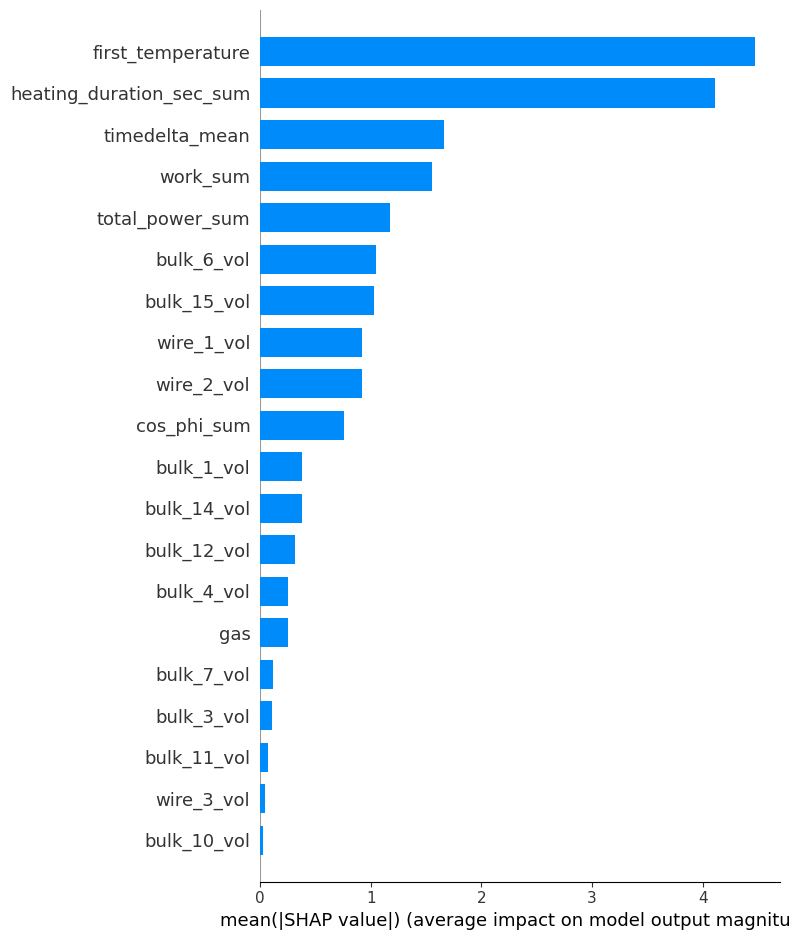

In [138]:
explainer = shap.Explainer(model)
shap_values = explainer(features_test)
shap.summary_plot(shap_values, features_test, plot_type='bar')

По результатам анализа видно, что больше всего на конечную температуру сплава влияет изначальная температура стали, время нагрева сплава (сек), время между замерами температуры образцов (что уже не так очевидно, как первые два пункта). Из легирующих добавок больше всего на конечную температуру плавления стали влияют bulk_6 и bulk_15, а также wire_1 и wire_2.

## Проверка адекватности модели

Вычислим метрику МАЕ для константной модели, которая будет предсказывать среднюю температуру сплава из обучающего набора для всех данных тестовой выборки:

In [139]:
predicted_mean= pd.Series(target_train.mean(), index=target_test.index)
mae_mean = mean_absolute_error(target_test, predicted_mean)
print(f'MAE базовой модели, предсказывающей среднее значение температуры сплава: {round(mae_mean, ndigits=3)}')
print(f'MAE CatBoostRegressor на тесте: {round(cb_mae_test, ndigits=3)}')

MAE базовой модели, предсказывающей среднее значение температуры сплава: 8.096
MAE CatBoostRegressor на тесте: 5.768


Мы использовали базовую модель, которая предсказывает среднее значение целевой переменной на обучающей выборке для тестовой выборки и рассчитали среднюю абсолютную ошибку между предсказанными значениями и истинными значениями конечной температуры плавления на тестовой выборке. Наша модель CatBoost является адекватной и может быть рекомендована к использованию.

## Вывод

Металлургический комбинат предоставил нам данные из разных источников: по электродам, времени нагрева, объемам и времени добавления легирующих добавок (сыпучих и проволоки), а также объему подачи газа для смешивания стали с примесями. Часть данных - по электродам и по измерениям температур сплава - имеют несколько наблюдений для каждой партии. Данные имеют физический характер и большинство нормально распределены. Мы увидели много пропусков в данных по легирующим добавкам: объемы мы заменили нулями (0 = нулевой объем добавки), что в конечном счете отобразилось как аномалии в распределении данных, но избавляться мы от них не стали (как и от других аномалий, например, «хвостов» гистограммы), чтобы модель могла обучиться на полноценных, а не урезанных данных. Удалили информацию о партиях, где температура плавления была ниже +1350С. Агрегировали датафреймы data_arc и data_temp, параллельно создав несколько новых признаков для модели:  
  
    - total_power - полная мощность    
    - heating_duration_sec - продолжительность нагрева (секунды)  
    - cos_phi - коэффициент мощности  
    - work - работа  
    - first_sampling_time - время первого замера  
    - last_sampling_time - время последнего замера  
    - first_temperature - первую измеренную температуру  
    - last_temperature - последнюю измеренную температуру  
    - iterations_count - количество итераций внутри одной партии  
    - timedelta_mean - среднее время между итерациями  
  
Уже после агрегации данных мы удалили все партии, где не была указана конечная температура плавления сплава и средняя продолжительность итераций.  Все признаки, связанные со временем добавления легирующих материалов мы удалили, т.к. они имели много пропусков и не имели корреляции с целевой переменной. Также для борьбы с мультиколлинеарность мы удалили признаки, где коэффициент корреляции был >0.9.  Итоговый датасет разделили на обучающую и тестовую выборки в соотношении 3:1.  
  
Для обучения мы рассмотрели три модели: линейную регрессию (c предварительной стандартизацией данных), catboost и lgbm. На кросс-валидации лучшую метрику МАЕ показал СatBoostRegressor: 5.980, на втором месте LGBMRegressor: 6.128, на последнем линейная регрессия: 6.391. CatBoost обучался значительно дольше двух других моделей, но так как у нас не было цели уменьшить время обучения, в итоге мы рекомендовали заказчику эту модель для использования, как модель с лучшей метрикой МАЕ на кросс-валидации. На тесте CatBoost дал метрику 5.768, что является очень хорошим результатом и достаточным для данной задачи. Причем мы с уверенностью можем сказать, что модель дала адекватный результат, т.к. обычная базовая модель, которая предсказывает среднее значение таргета обучающей выборки для каждой партии тестовой выборки дала МАЕ > 8 на тесте.    
  
По результатам анализа видно, что больше всего на конечную температуру сплава влияет изначальная температура стали, время нагрева сплава (сек), время между замерами температуры образцов (что уже не так очевидно, как первые два пункта). Из легирующих добавок больше всего на конечную температуру плавления стали влияют bulk_6 и bulk_15, а также wire_1 и wire_2.  
  
Как итог: мы рекомендуем клиенту использовать модель СatBoostRegressor с гиперпараметрами learning_rate=0.03, l2_leaf_reg=1, iterations=1000, depth=4 для получения предсказаний итоговой температуры сплава с допустимой точностью, а также в дальнейшем в случае изменения и попытки улучшения технологических процессов для снижения энергозатрат обращать больше внимания на начальную температуру стали, время нагрева сплава, время между разными итерациями внутри одной партии, а также на объем легирующих добавок bulk_6, bulk_15, wire_1 и wire_2, т.к. именно эти признаки оказывают наибольшее влияние на итоговую температуру плавления стали.